In [1]:
from utils.dataloader import *
import pandas as pd
from matplotlib import pyplot as plt
import cv2 as cv
from utils.sift import *
from utils.helper import strech_img, plot_img_and_hist

In [2]:
RANDOM_STATE = 66
ROOT_PATH, DATA_PATH, OUT_PATH = get_paths()
print(ROOT_PATH)

/Users/moooooo16/Documents/Computer Vision/Project/elpv


In [3]:
img_path, prob, types, labels= load_data(DATA_PATH)

print(len(img_path), 
      len(prob),
      len(types),
      len(labels))

[0 1 2 3 4 5 6 7] [588 117  56 313 920 178  50 402]
2624 2624 2624 2624


In [4]:
data = pd.DataFrame({'img_path': img_path, 'prob': prob, 'types': types})
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2624 entries, 0 to 2623
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   img_path  2624 non-null   object 
 1   prob      2624 non-null   float64
 2   types     2624 non-null   object 
dtypes: float64(1), object(2)
memory usage: 61.6+ KB


In [5]:
data.agg(['count', 'nunique'])

,img_path,prob,types
count,2624,2624,2624
nunique,2624,4,2


In [6]:
data['prob'].value_counts()

0.000000    1508
1.000000     715
0.333333     295
0.666667     106
Name: prob, dtype: int64

In [7]:
data['types'].value_counts()

poly    1550
mono    1074
Name: types, dtype: int64

In [8]:
data.groupby(['prob', 'types']).size()

prob      types
0.000000  mono     588
          poly     920
0.333333  mono     117
          poly     178
0.666667  mono      56
          poly      50
1.000000  mono     313
          poly     402
dtype: int64

(300, 300)


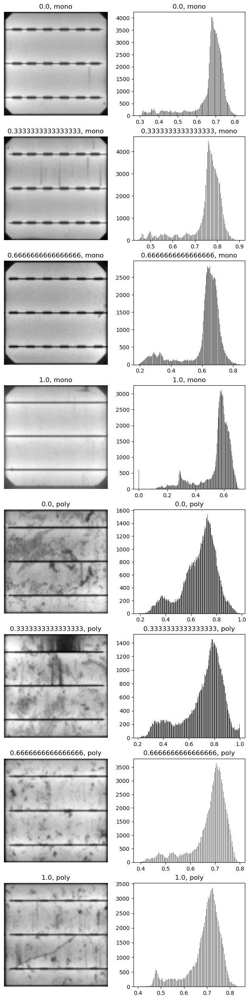

(300, 300)


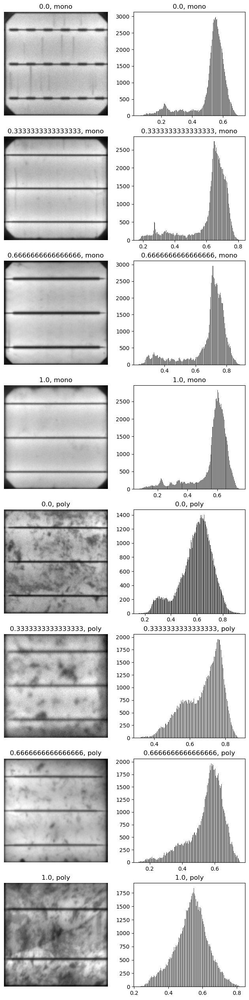

(300, 300)


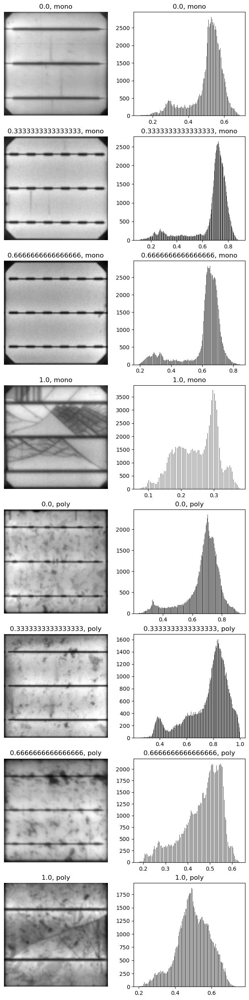

(300, 300)


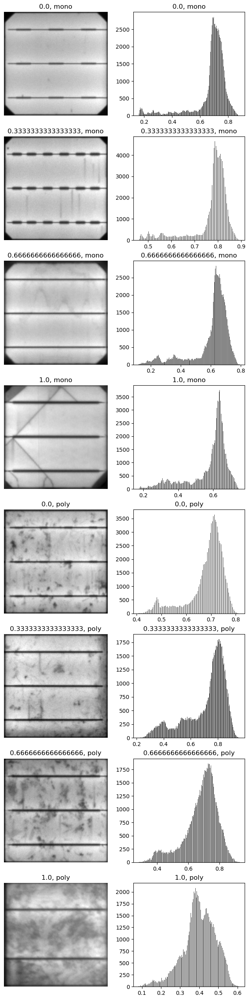

(300, 300)


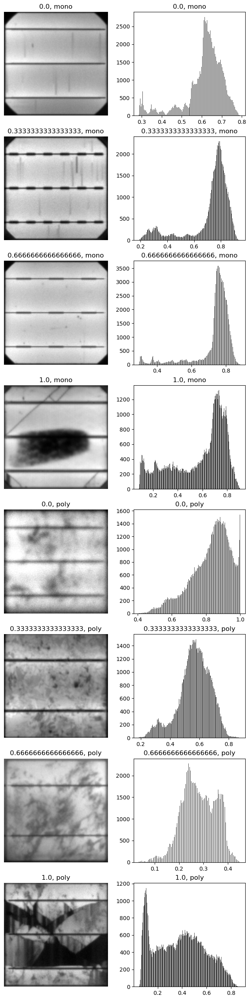

(300, 300)


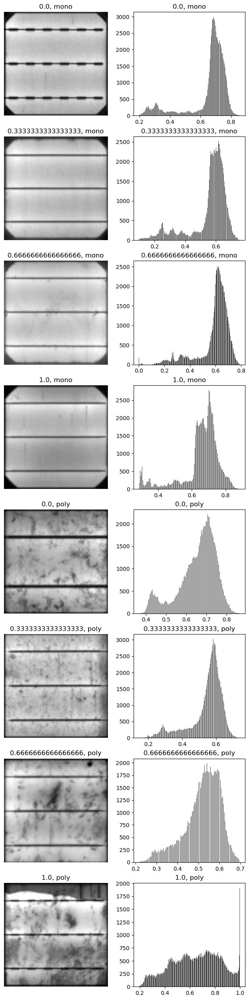

In [9]:
def at_galance(seed = 99, img_dir = DATA_PATH, data = data):
    grouped = data.groupby(['types', 'prob'])
    sample = grouped.apply(lambda x: x.sample(1)).reset_index(drop=True)

    
    _, axes = plt.subplots(8,2, figsize=(8, 32))
    
    for idx, row in sample.iterrows():


        img = plt.imread(os.path.join(img_dir, row['img_path']))
        
        if idx== 0:
            print(img.shape)
            
        axes[idx, 0].imshow(img, cmap='gray')
        axes[idx, 0].set_title(f'{row["prob"]}, {row["types"]}')
        axes[idx, 0].axis('off')
        
        axes[idx, 1].hist(img.flatten(), bins=256, color='black', alpha=0.7)
        axes[idx, 1].set_title(f'{row["prob"]}, {row["types"]}')
    
    plt.show()
            
    return sample

for i in range(6):
    at_galance(i)

<Axes: xlabel='prob'>

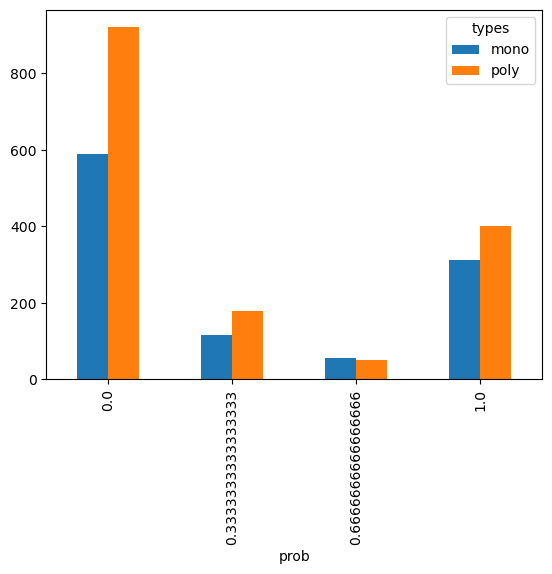

In [10]:
data.groupby(['prob', 'types']).size().unstack().plot(kind='bar')

# Findings

- Class label interpreter:
  - fully functional (0% probability of being defective), 
  - possibly defective (33% probability), 
  - likely defective (67% probability), or 
  - certainly defective (100% probability).

- Mono and poly are different in
  - shape of img background
  - defect pattern
  - mono-crystalline silicon wafers and multi-crystalline silicon wafers
  - mono and poly are balanced
- Defecet are not clear to naked eye
- Images are 8 bits gray-scale, 300 x 300 pixels
- class are imbalanced, with majority are "fully functional"


From paper:
- Expert identified 12 features intrinsic to most PV modules
- 12 defecet extrinsic to solar cells
- 


In [7]:
def thresholding(img, prob, types):

    otsu, otsu_threh = my_otsu(img)
    isodata, isodata_thresh = my_isodata(img)
    # triangle = cv2.threshold(img, 0, 255, cv2.THRESH_TRIANGLE)[1]
    triangle, triangle_thresh = my_triangle(img)
    
    _, ax = plt.subplots(1, 5, figsize=(25,5))
    
    ax[0].imshow(img, cmap='gray')
    ax[0].set_title(f'{prob}, {types}')
    
    ax[1].hist(img.ravel(), bins=256, range=(0, 255), color = 'black')
    
    ax[1].axvline(otsu_threh, color='r')
    ax[1].axvline(isodata_thresh, color='g')
    ax[1].axvline(triangle_thresh, color='b')
    ax[1].legend(['Otsu', 'Isodata', 'Triangle'])
    ax[1].set_title('Histogram')
    
    ax[2].imshow(otsu, cmap='gray')
    ax[2].set_title('My Otsu')
    
    ax[3].imshow(isodata, cmap='gray')
    ax[3].set_title('Isodata')

    ax[4].imshow(triangle, cmap='gray')
    ax[4].set_title('Triangle')
    
    # print(f'Otsu threshold: {otsu_threh}')
    # print(f'Isodata threshold: {isodata_thresh}')
    # print(f'Triangle threshold: {triangle_thresh}')


In [17]:
def transformation(img):
    grouped = data.groupby(['prob', 'types'])
    sample = grouped.apply(lambda x: x.sample(1)).reset_index(drop=True)
    
    for idx, row in sample.iterrows():
        img = plt.imread(os.path.join(DATA_PATH, row['img_path']))
        thresholding(img*255, row['prob'], row['types'])

In [19]:
kernel = np.array([[1, 1, 1,], [1, -8, 1], [1, 1, 1]])

def zero_crossing(img, threshold=0):
    
    
    
    result = np.zeros_like(img).astype(np.uint8)
    
    
    
    for i in range(1, img.shape[0]-1):
        for j in range(1, img.shape[1]-1):
            
            if result[i, j] != 0:
                continue
            
            if img[i-1, j-1] * img[i+1, j+1] < threshold:
                result[i, j] = 255
                continue
            
            if img[i-1, j] * img[i+1, j] < threshold:
                result[i, j] = 255
                continue
            
            if img[i-1, j+1 ] * img[+1, j-1] < threshold:
                result[i, j] = 255
                continue
            
            if img[i, j-1] * img[i, j+1] < threshold:
                result[i, j] = 255
                continue
            
            
    return result
    
def streching_function(x,c,d):
    return np.clip((x - c) * (255 / (d - c)), 0, 255)

def laplacian_image(img=None, kernel=kernel):
    
    img = img.astype(np.float32)
    kernel = kernel.astype(np.float32)
    
    step = kernel.shape[0] // 2
    
    laplacian = np.zeros_like(img)
    
    # i is x, j is y
    for i in range(step, img.shape[0] - step):
        for j in range(step, img.shape[1] - step):
            # print(img[i-step:i+step+1, j-step:j+step+1])
            laplacian[i, j] = np.sum(img[i-step:i+step+1, j-step:j+step+1] * kernel)
    
    return laplacian

laplacian = laplacian_image(img = img*255)
    

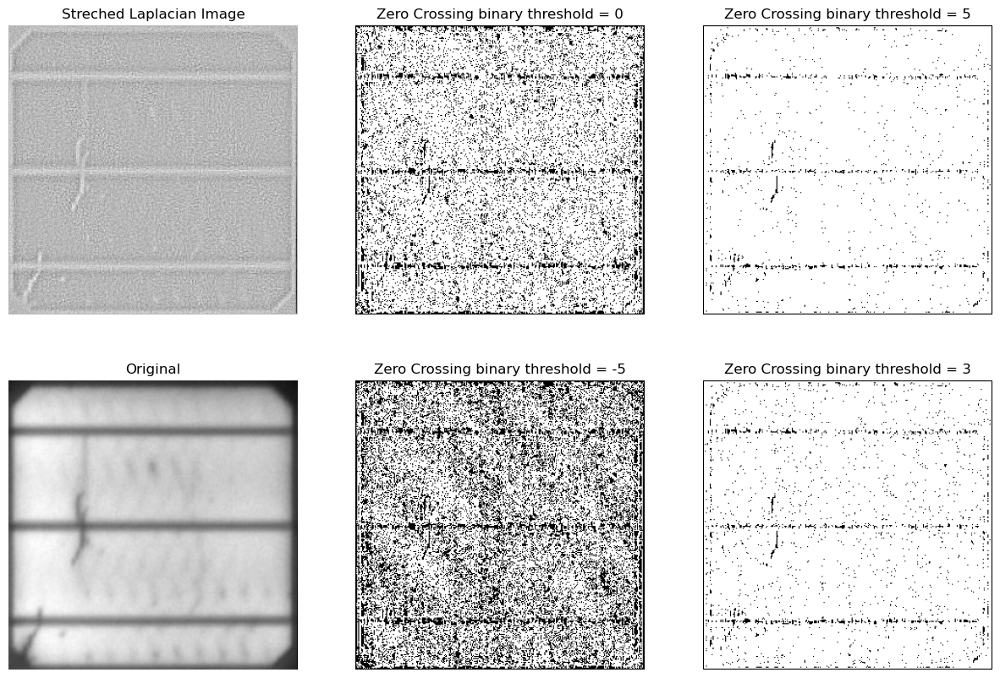

In [20]:

def plot_laplacian(img, laplacian):
    
    threhsold1 = 0
    threshold2 = 5
    threshold3 = -5
    threshold4 = 3
    threshold5 = -3
    
    zero_crossing_1 = zero_crossing(laplacian.copy(), threshold=threhsold1).astype(np.uint8)
    zero_crossing_2 = zero_crossing(laplacian.copy(), threshold=threshold2).astype(np.uint8)
    zero_crossing_3 = zero_crossing(laplacian.copy(), threshold=threshold3).astype(np.uint8)
    zero_crossing_4 = zero_crossing(laplacian.copy(), threshold=threshold4).astype(np.uint8)
    zero_crossing_5 = zero_crossing(laplacian.copy(), threshold=threshold5).astype(np.uint8)
                
    streched = streching_function(laplacian.copy(), np.min(laplacian), np.max(laplacian)).astype(np.uint8)
    
    # bright = laplacian.copy()
    # bright[bright < 0] = 0
    # bright[bright > 255] = 255
    
    # dark = laplacian.copy()
    # dark[dark > 0] = 0
    # dark[dark < -255] = -255
    
    _, axes = plt.subplots(2, 3, figsize=(15,10))
    
    
    axes[0,0].imshow(streched, cmap='gray', vmin=0, vmax=255)
    axes[0,0].set_title('Streched Laplacian Image')
    axes[0,0].axis('off')
    
    
    axes[0,1].imshow(zero_crossing_1, cmap='gray')
    axes[0,1].set_title(f'Zero Crossing binary threshold = {threhsold1}')
    axes[0,1].axis('off')
    
    axes[0,2].imshow(zero_crossing_2, cmap='gray')
    axes[0,2].set_title(f'Zero Crossing binary threshold = {threshold2}')
    axes[0,2].axis('off')
    
    
    axes[1,0].imshow(img, cmap='gray')
    axes[1,0].set_title('Original')
    axes[1,0].axis('off')
    
    axes[1,1].imshow(zero_crossing_3, cmap='gray')
    axes[1,1].set_title(f'Zero Crossing binary threshold = {threshold3}')
    axes[1,1].axis('off')
    
    axes[1,2].imshow(zero_crossing_4, cmap='gray')
    axes[1,2].set_title(f'Zero Crossing binary threshold = {threshold4}')
    axes[1,2].axis('off')
    # axes[3].imshow(bright, cmap='gray')
    # axes[3].set_title('Bright part')
    # axes[3].axis('off')

    
    plt.show()
    
plot_laplacian(img*255, laplacian)

In [21]:
sift = SIFT(DATA_PATH, img_path, processing_funcs=[])
kps, descriptor, empty_descriptor = sift.calculate_desriptor(mask=None)
print(empty_descriptor)

Calculating descriptors: 100%|██████████| 2624/2624 [00:18<00:00, 139.83it/s]

[1835, 1836, 1842, 1843, 1894, 1895, 1896, 1902, 1903, 2326, 2327, 2329, 2334, 2335]


In [26]:
sift2 = SIFT(DATA_PATH, img_path, processing_funcs=[strech_img])
kps2, descriptor2, empty_descriptor2 = sift2.calculate_desriptor(mask=None)
print(empty_descriptor2)

Calculating descriptors: 100%|██████████| 2624/2624 [00:19<00:00, 132.08it/s]

[]


In [9]:
grouped_indices = {}
num_indices = 3
for label in range(8):

    indices_for_label = np.where(np.array(labels) == label)[0]
    selected_indices = np.random.choice(indices_for_label, num_indices, replace=False)
    grouped_indices[label] = selected_indices

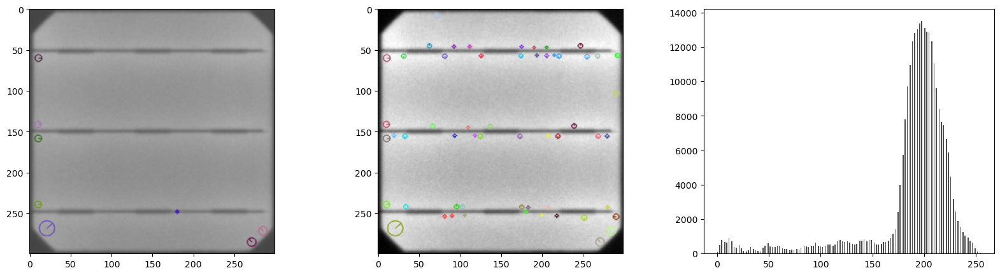

Class: 0, SIFT and SIFT2: are equal? False


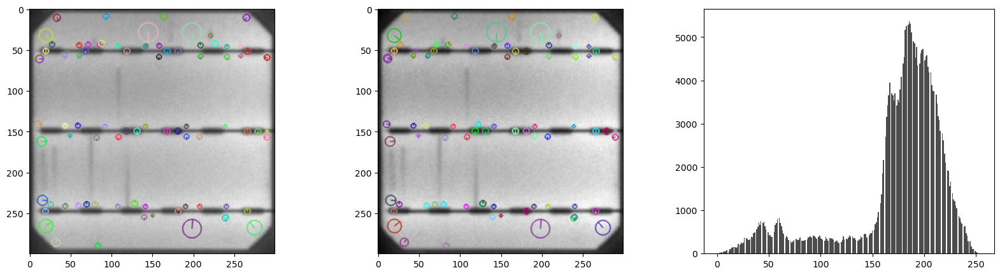

Class: 0, SIFT and SIFT2: are equal? False


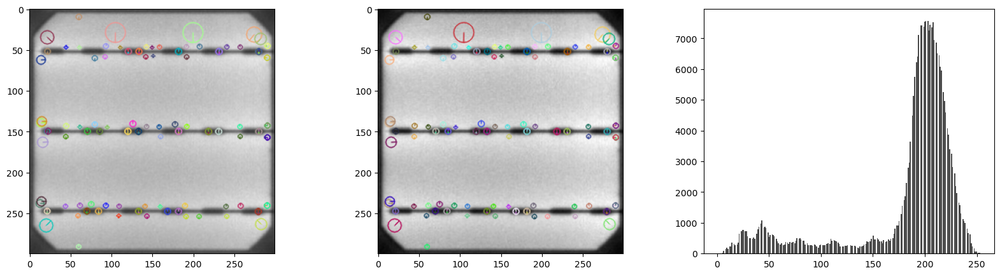

Class: 0, SIFT and SIFT2: are equal? False


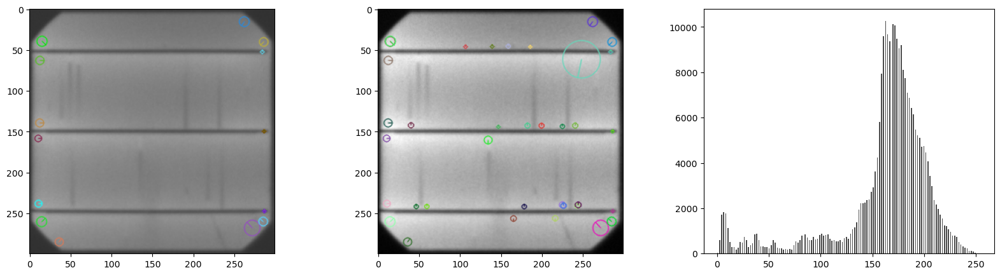

Class: 0, SIFT and SIFT2: are equal? False


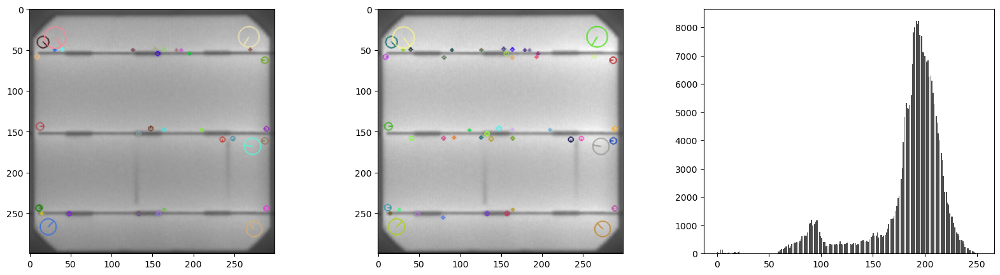

Class: 0, SIFT and SIFT2: are equal? False


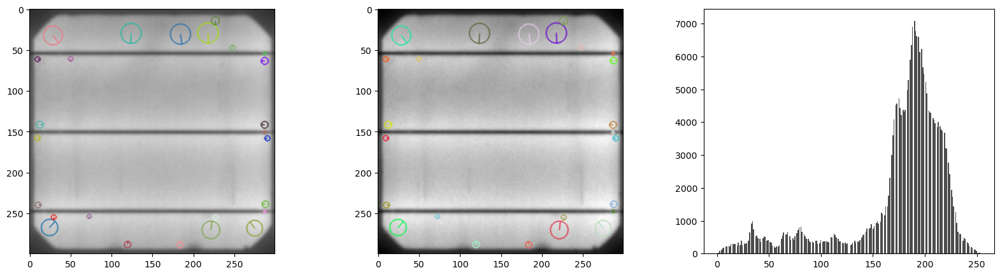

Class: 1, SIFT and SIFT2: are equal? False


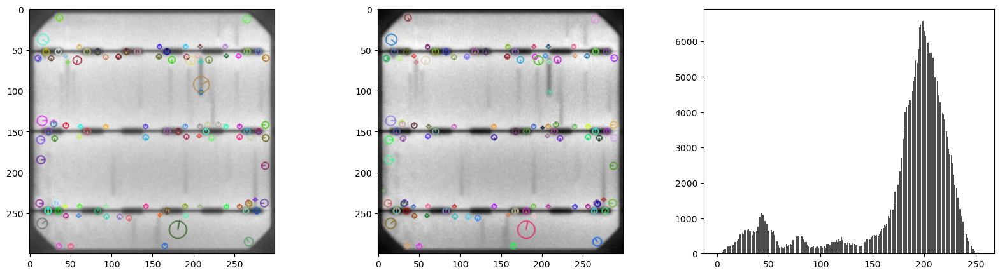

Class: 1, SIFT and SIFT2: are equal? False


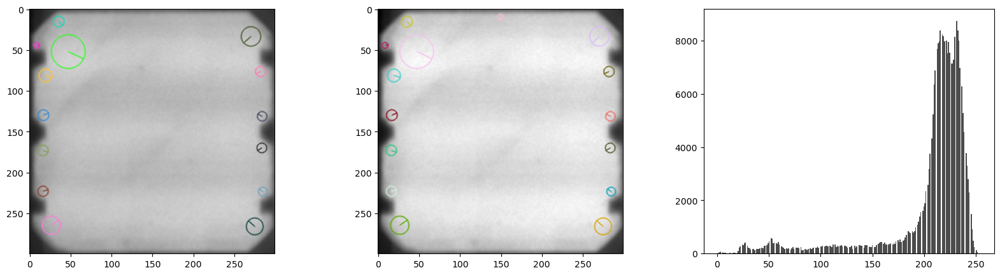

Class: 1, SIFT and SIFT2: are equal? False


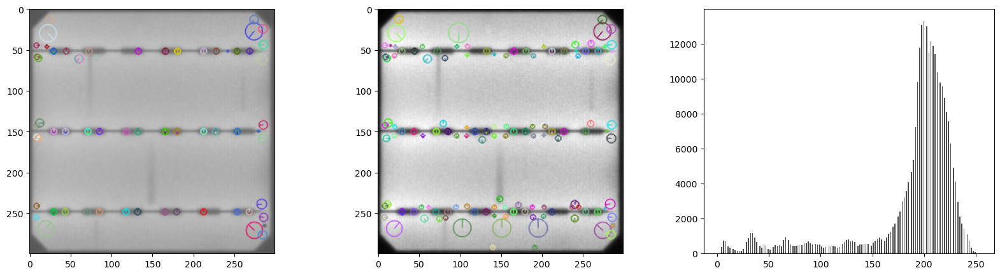

Class: 1, SIFT and SIFT2: are equal? False


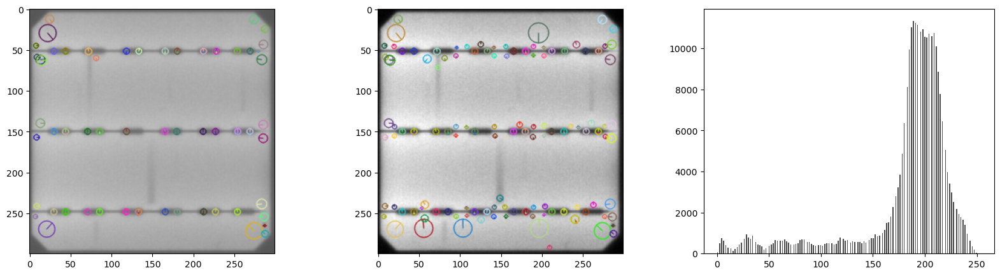

Class: 1, SIFT and SIFT2: are equal? False


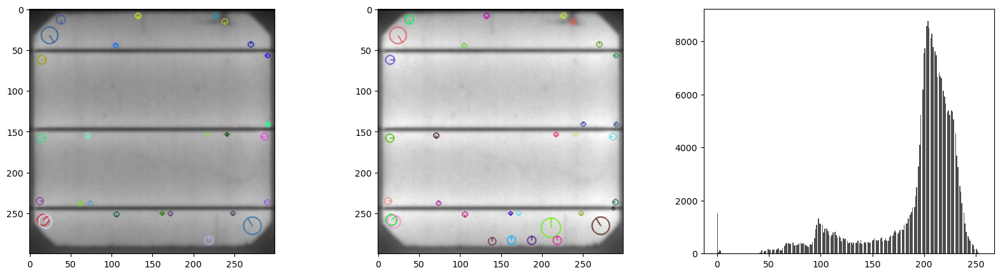

Class: 2, SIFT and SIFT2: are equal? False


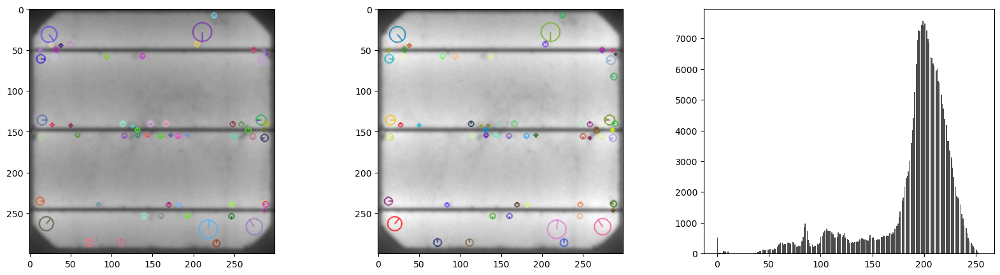

Class: 2, SIFT and SIFT2: are equal? False


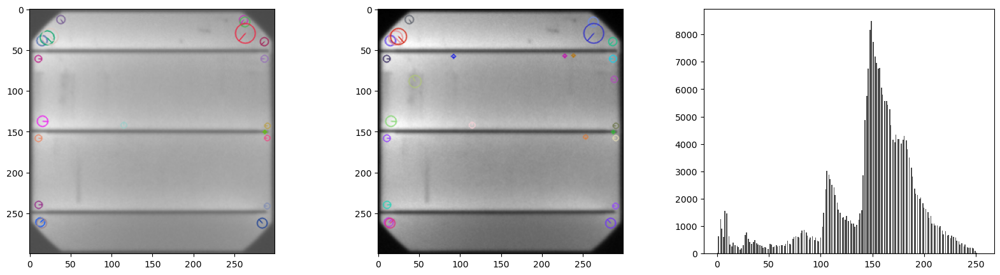

Class: 2, SIFT and SIFT2: are equal? False


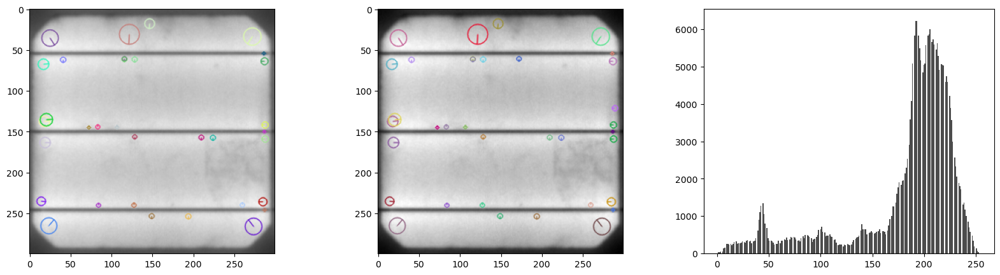

Class: 2, SIFT and SIFT2: are equal? False


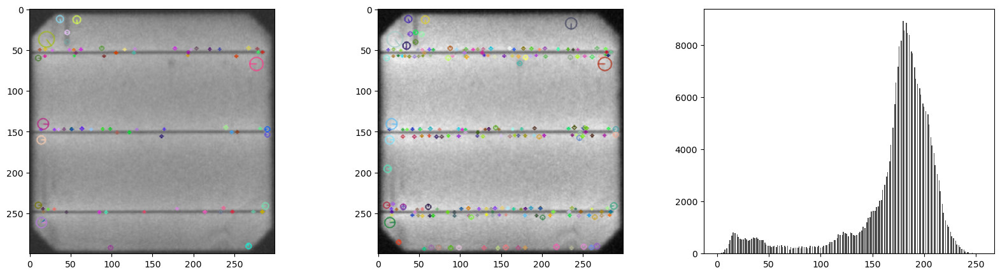

Class: 2, SIFT and SIFT2: are equal? False


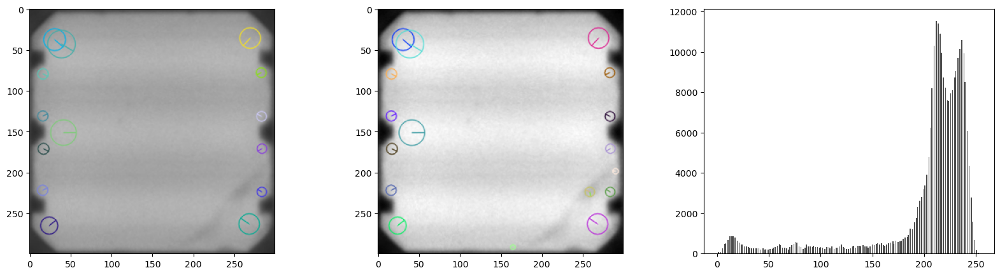

Class: 3, SIFT and SIFT2: are equal? False


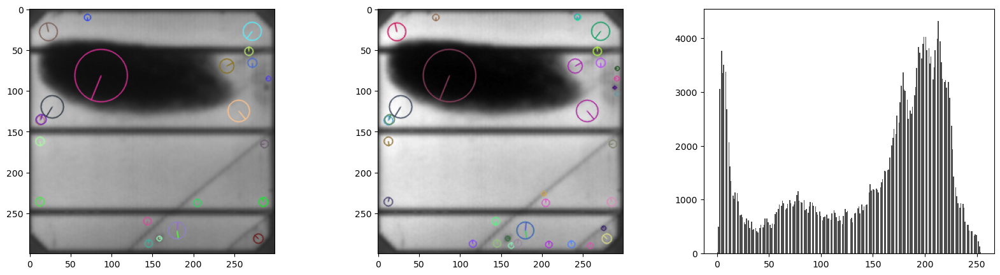

Class: 3, SIFT and SIFT2: are equal? False


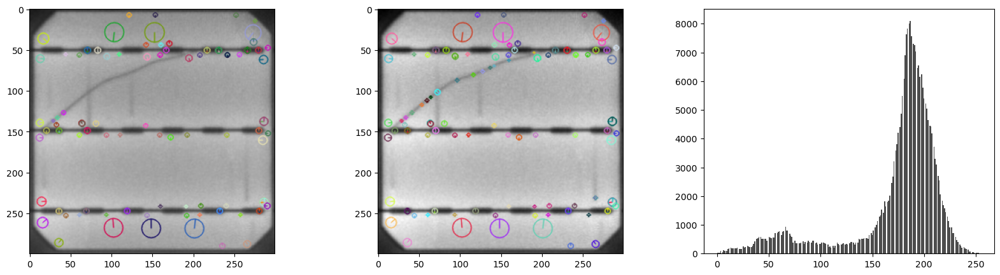

Class: 3, SIFT and SIFT2: are equal? False


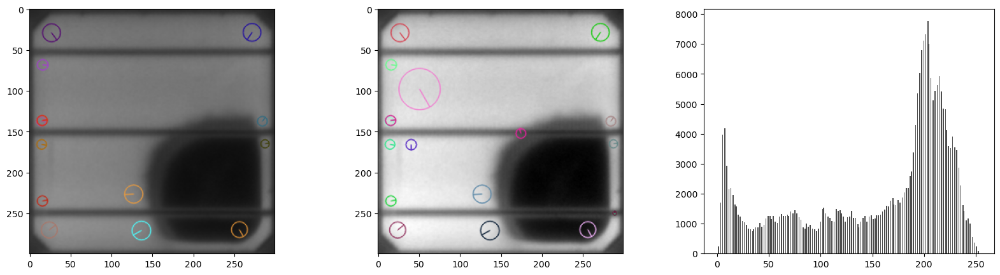

Class: 3, SIFT and SIFT2: are equal? False


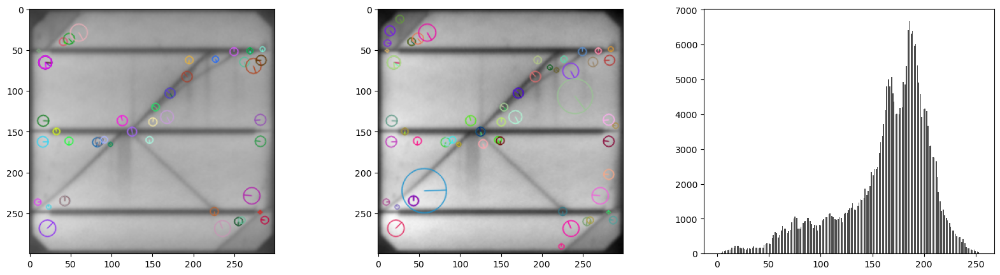

Class: 3, SIFT and SIFT2: are equal? False


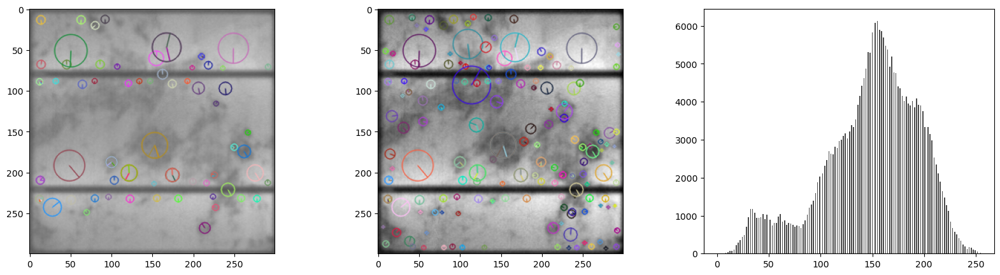

Class: 4, SIFT and SIFT2: are equal? False


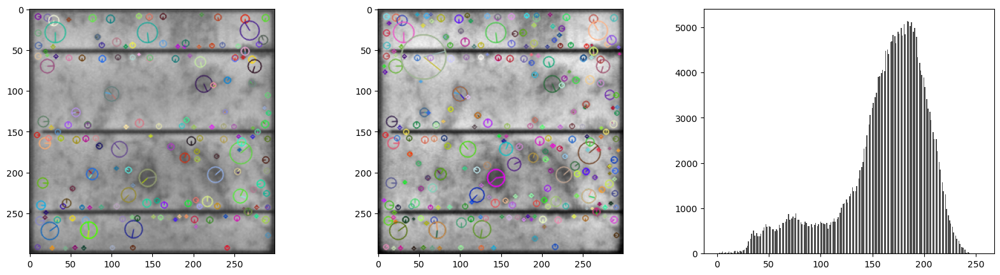

Class: 4, SIFT and SIFT2: are equal? False


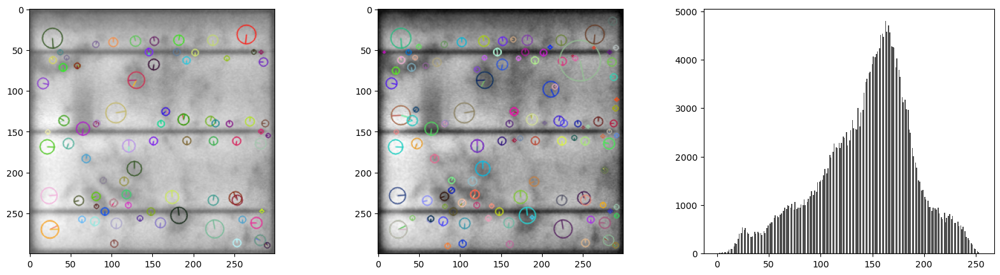

Class: 4, SIFT and SIFT2: are equal? False


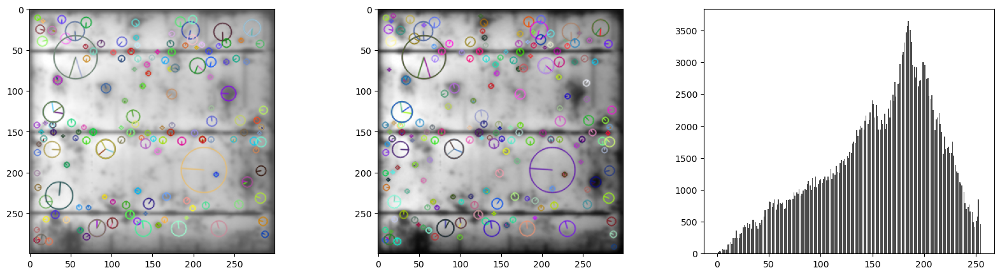

Class: 4, SIFT and SIFT2: are equal? False


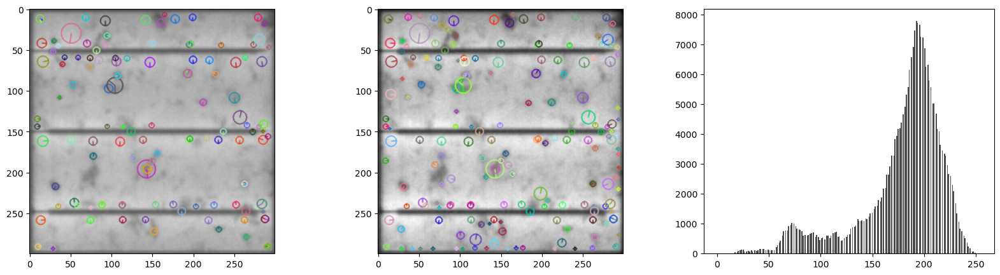

Class: 4, SIFT and SIFT2: are equal? False


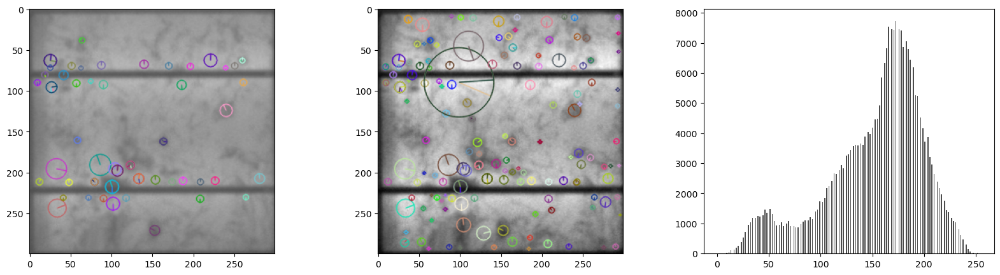

Class: 5, SIFT and SIFT2: are equal? False


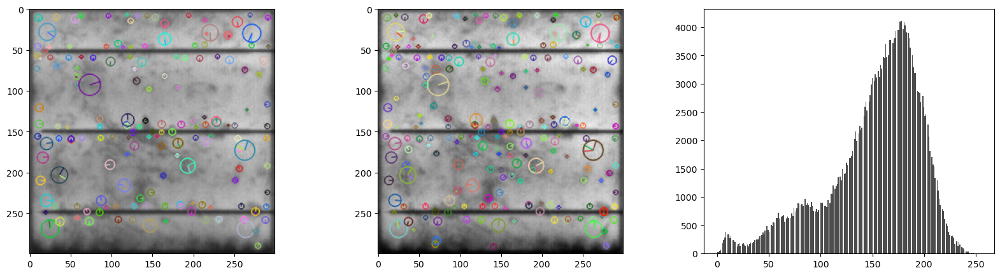

Class: 5, SIFT and SIFT2: are equal? False


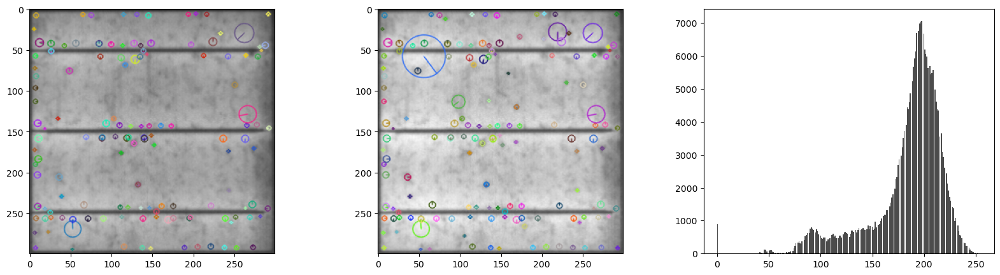

Class: 5, SIFT and SIFT2: are equal? False


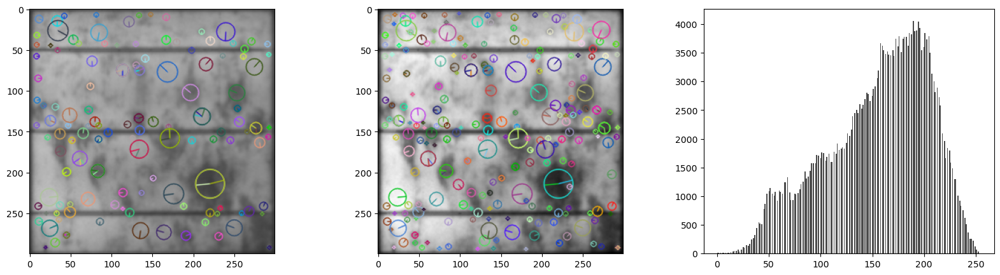

Class: 5, SIFT and SIFT2: are equal? False


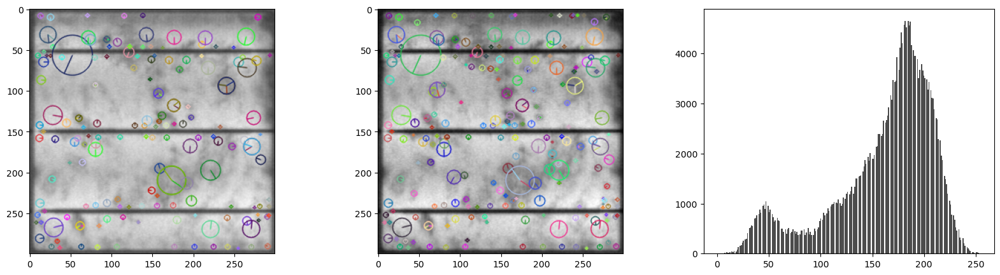

Class: 5, SIFT and SIFT2: are equal? False


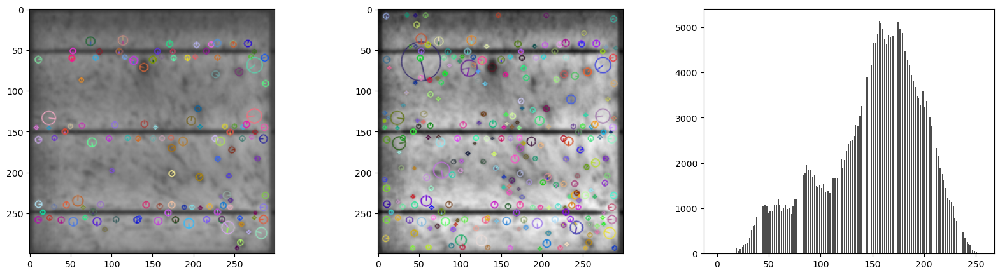

Class: 6, SIFT and SIFT2: are equal? False


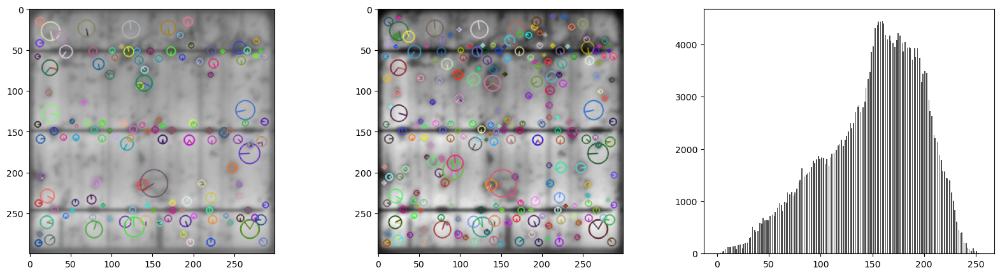

Class: 6, SIFT and SIFT2: are equal? False


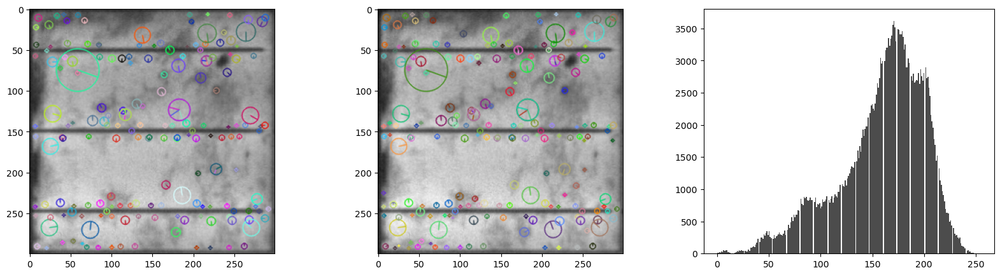

Class: 6, SIFT and SIFT2: are equal? False


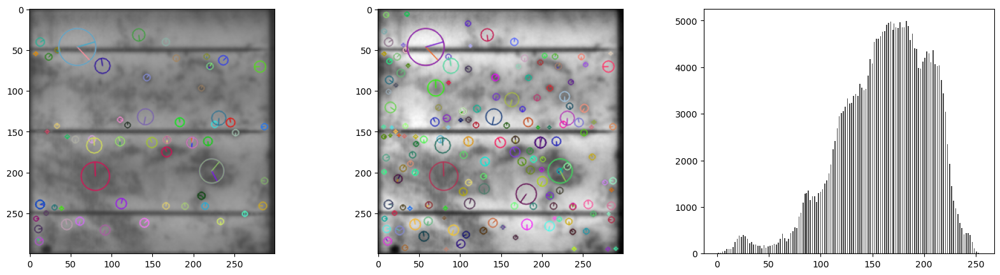

Class: 6, SIFT and SIFT2: are equal? False


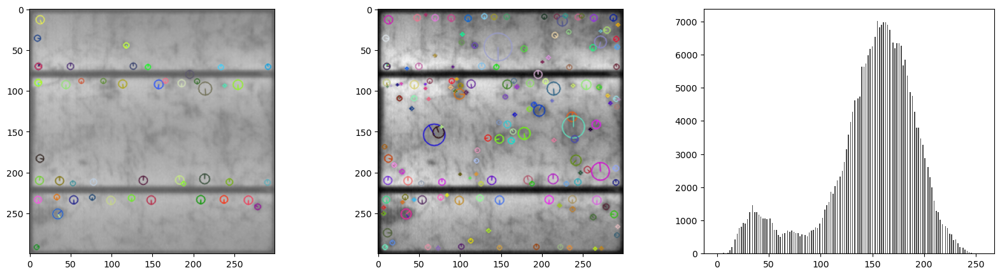

Class: 6, SIFT and SIFT2: are equal? False


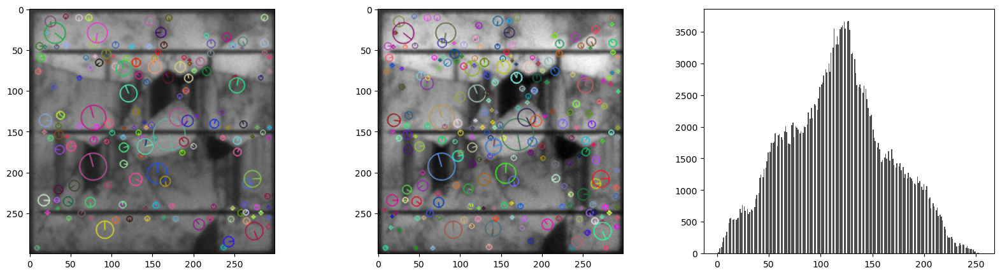

Class: 7, SIFT and SIFT2: are equal? False


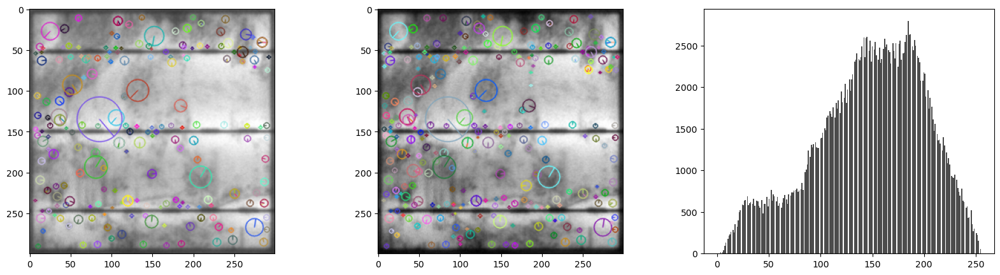

Class: 7, SIFT and SIFT2: are equal? False


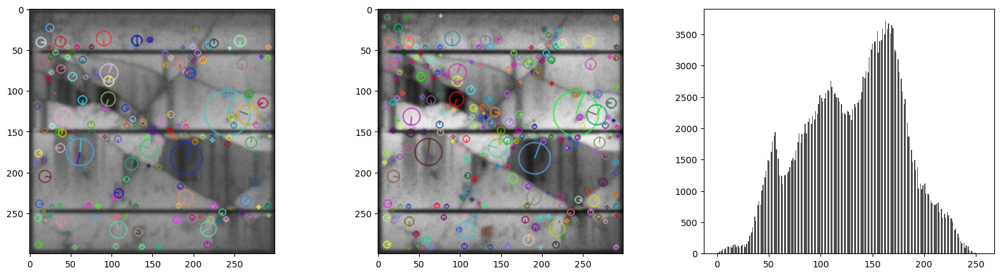

Class: 7, SIFT and SIFT2: are equal? False


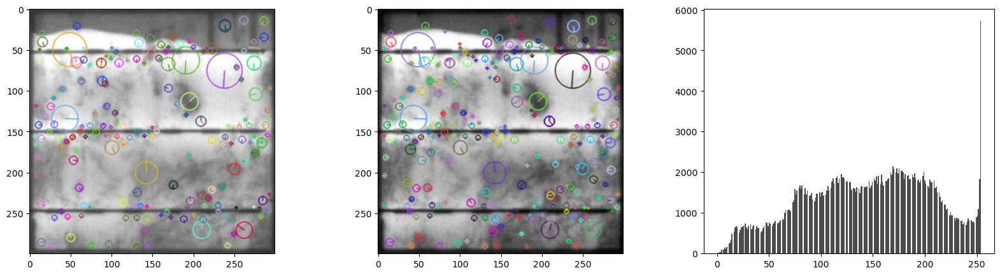

Class: 7, SIFT and SIFT2: are equal? False


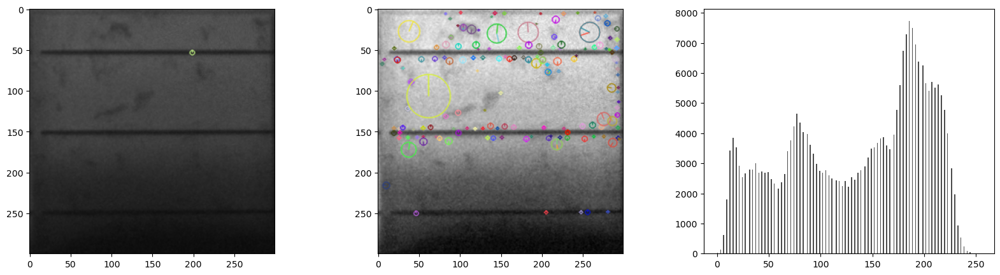

Class: 7, SIFT and SIFT2: are equal? False


In [27]:


for k, value in grouped_indices.items():

    for i in value:
        fig, ax = plt.subplots(1, 3, figsize=(20,5))
        
        img = cv.imread(os.path.join(DATA_PATH, img_path[i]))
        img2 = strech_img(img.copy())
        
        out = sift.draw(kps[i], img)
        out2 = sift2.draw(kps2[i], img2)
        
        ax[0].imshow(out)
        ax[1].imshow(out2)
        ax[2].hist(img2.flatten(), bins=256, color='black', alpha=0.7)
        plt.show()
        print(f'Class: {labels[i]}, SIFT and SIFT2: are equal? {np.array_equal(descriptor[i], descriptor2[i])}')

bin多一个多100

Class: 0, HOG shape: (46656,)


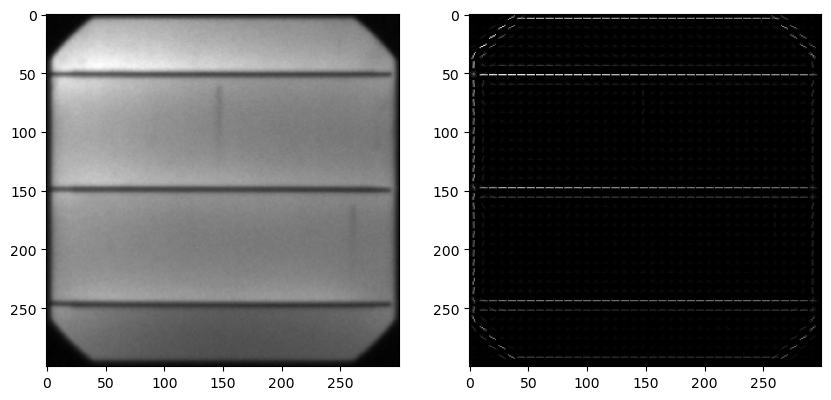

Class: 0, HOG shape: (46656,)


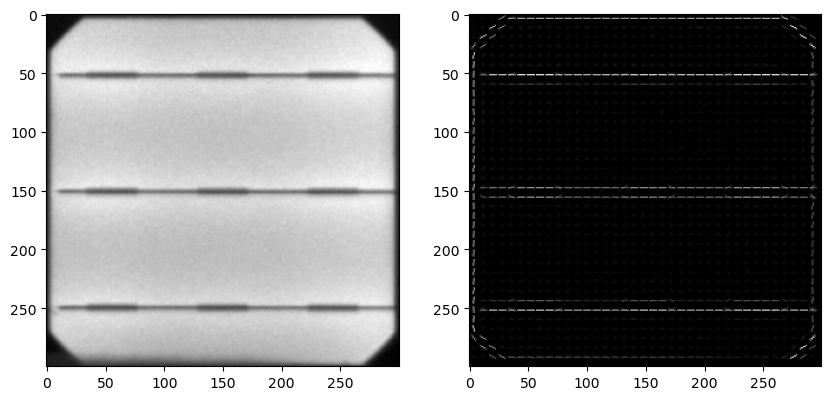

Class: 0, HOG shape: (46656,)


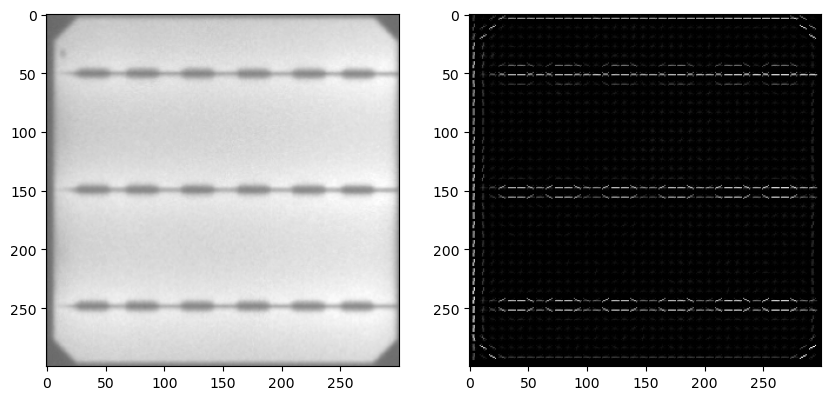

Class: 0, HOG shape: (46656,)


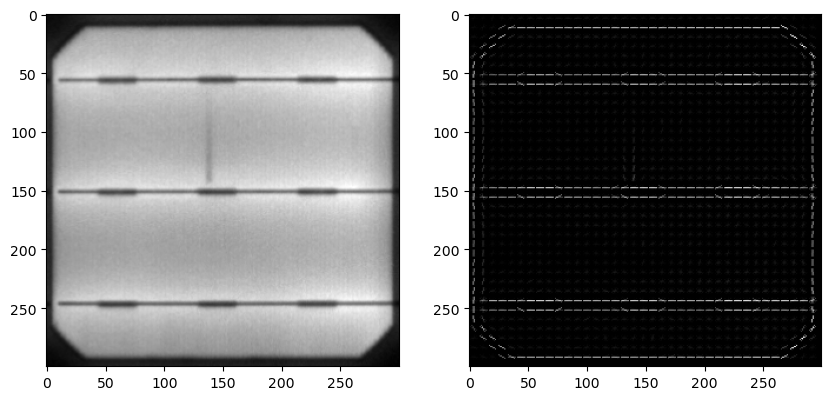

Class: 0, HOG shape: (46656,)


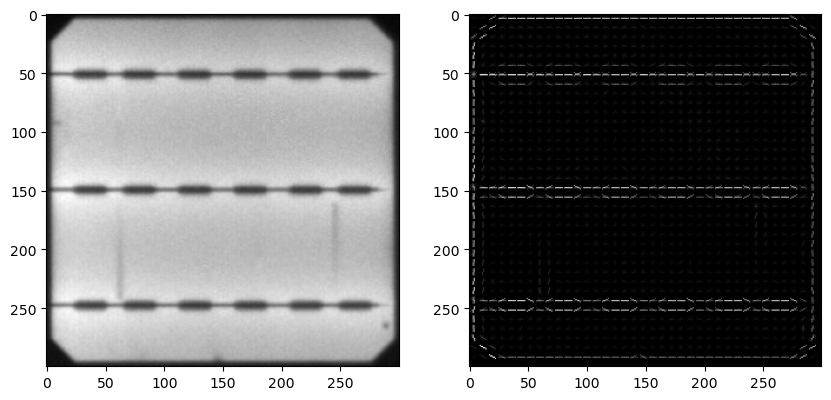

Class: 1, HOG shape: (46656,)


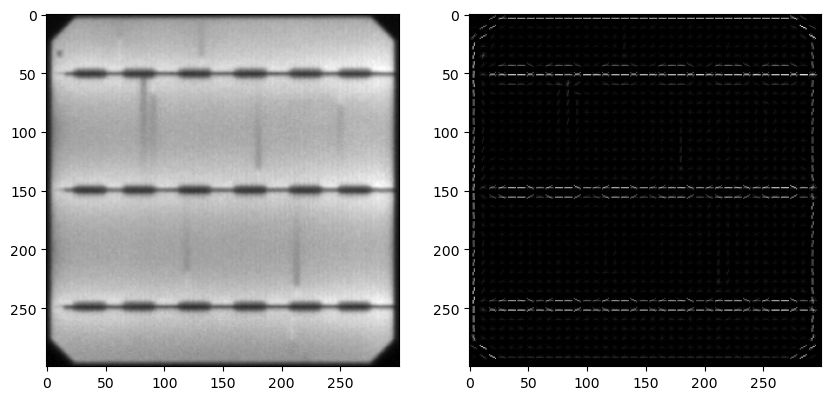

Class: 1, HOG shape: (46656,)


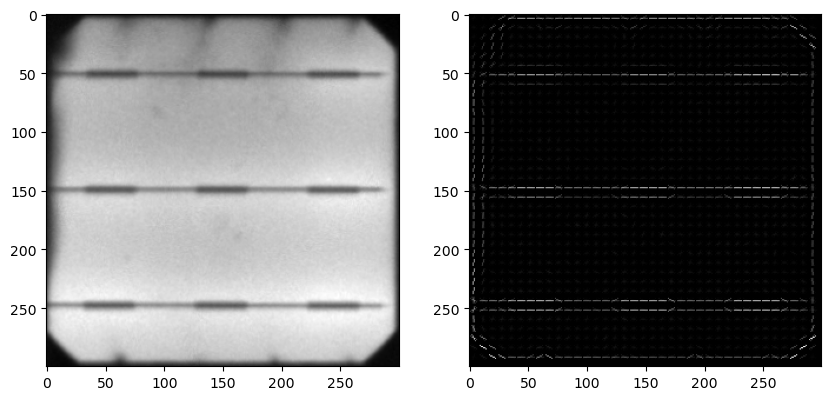

Class: 1, HOG shape: (46656,)


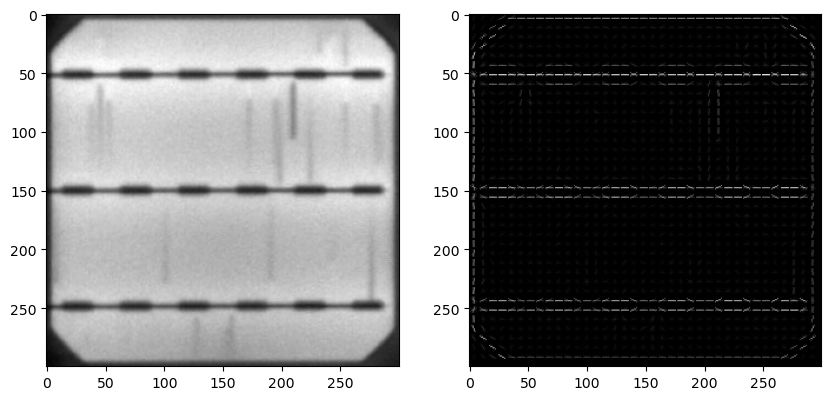

Class: 1, HOG shape: (46656,)


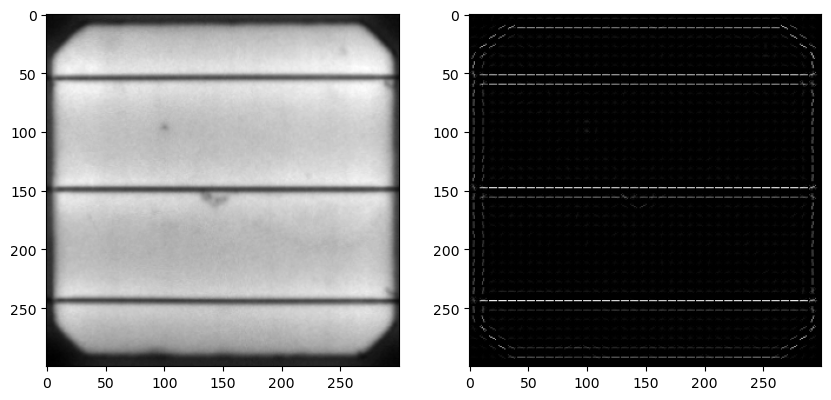

Class: 1, HOG shape: (46656,)


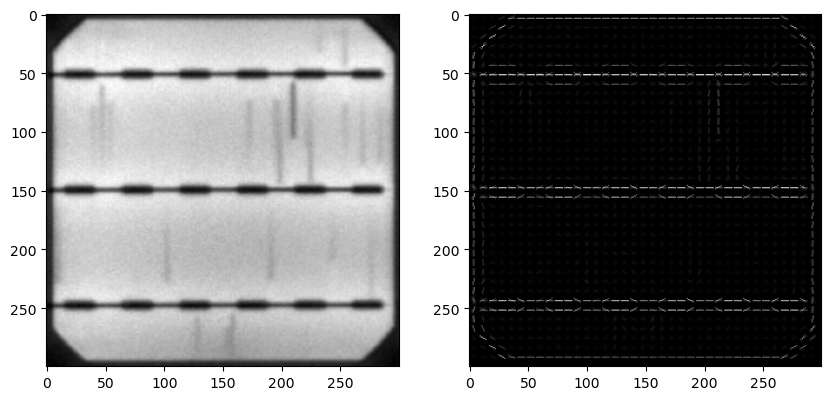

Class: 2, HOG shape: (46656,)


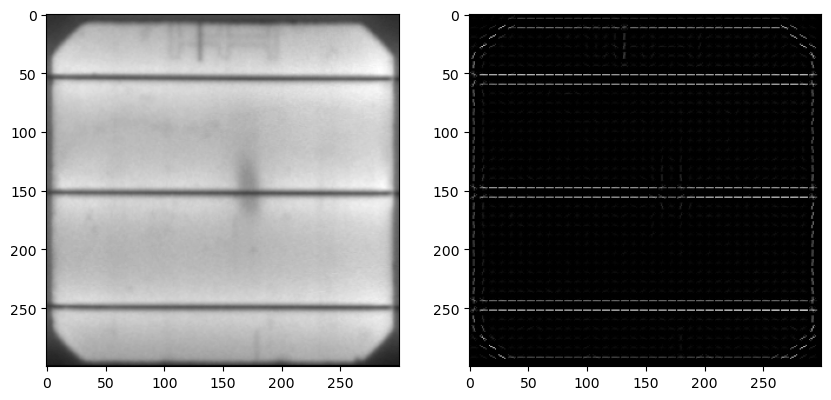

Class: 2, HOG shape: (46656,)


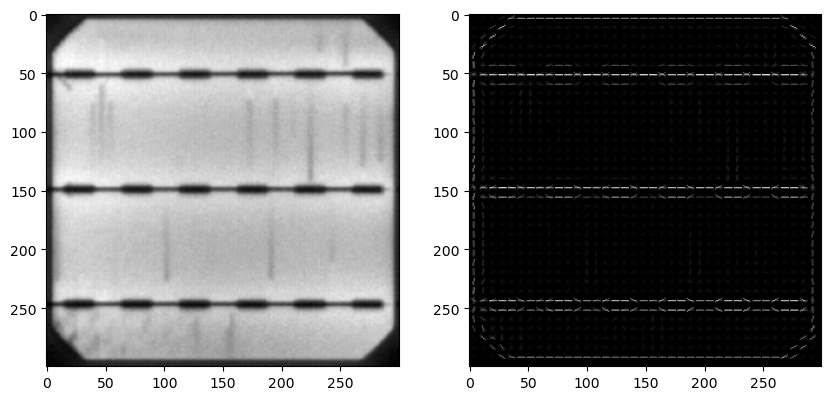

Class: 2, HOG shape: (46656,)


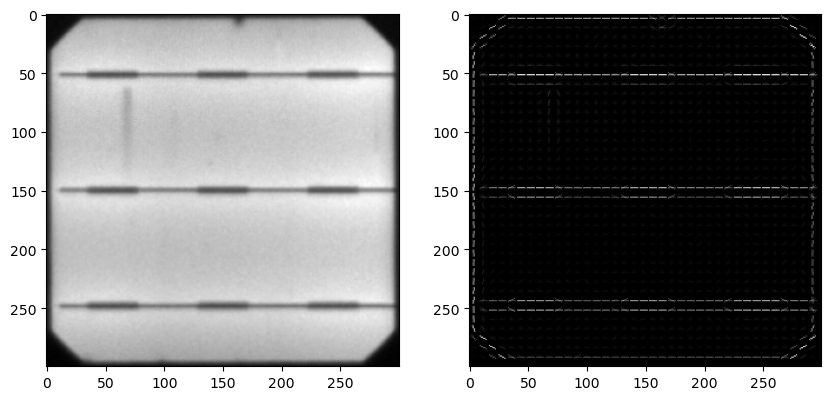

Class: 2, HOG shape: (46656,)


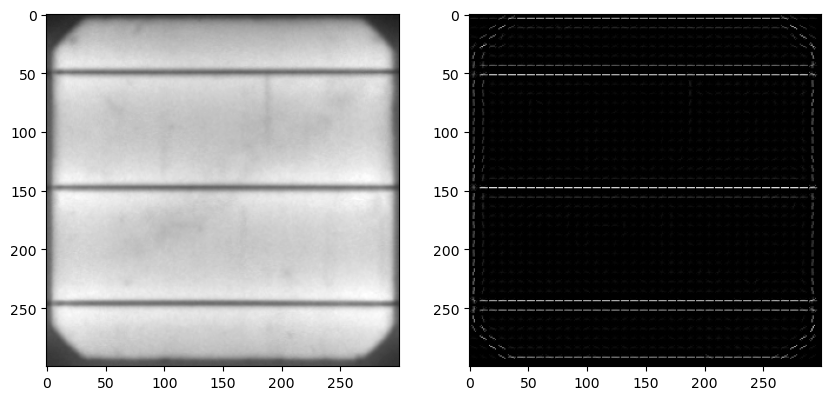

Class: 2, HOG shape: (46656,)


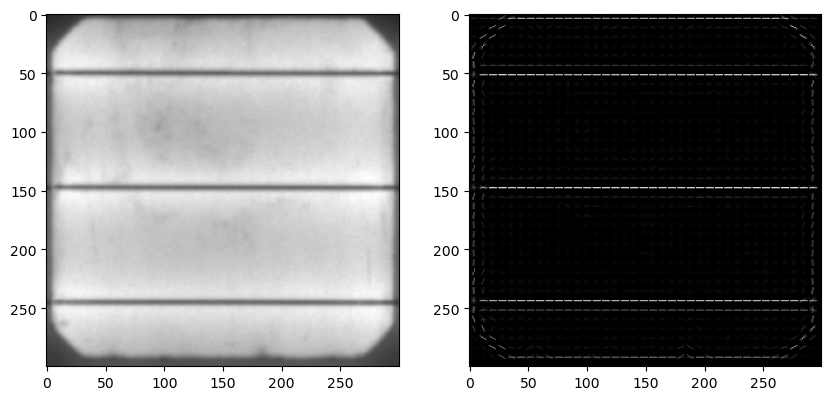

Class: 3, HOG shape: (46656,)


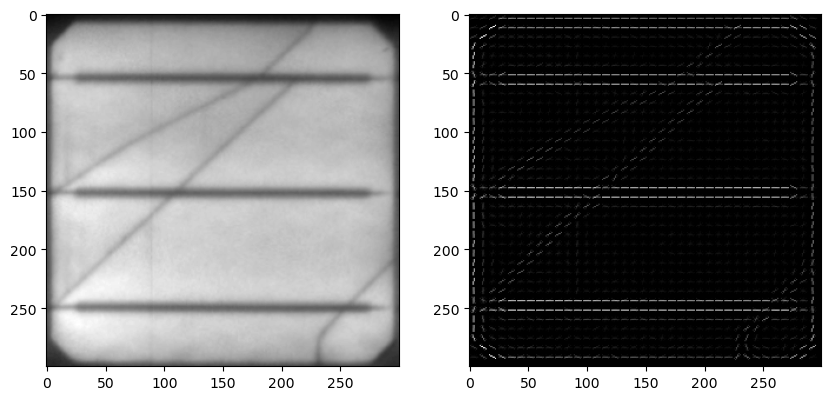

Class: 3, HOG shape: (46656,)


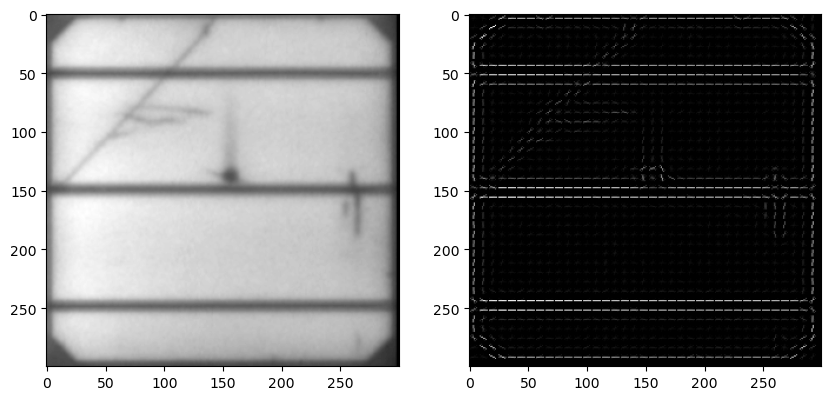

Class: 3, HOG shape: (46656,)


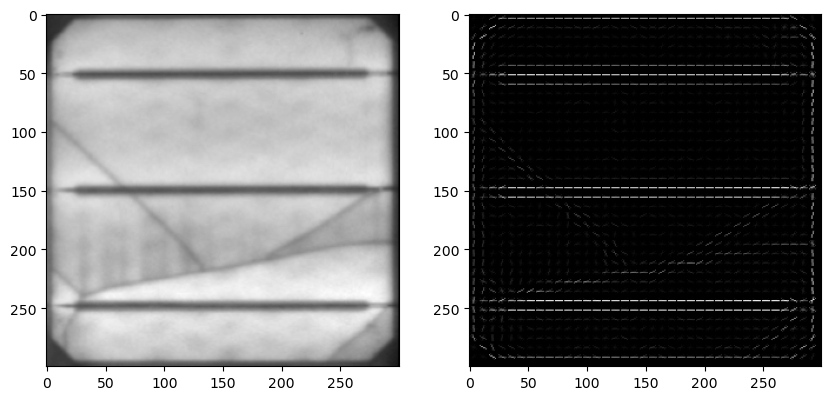

Class: 3, HOG shape: (46656,)


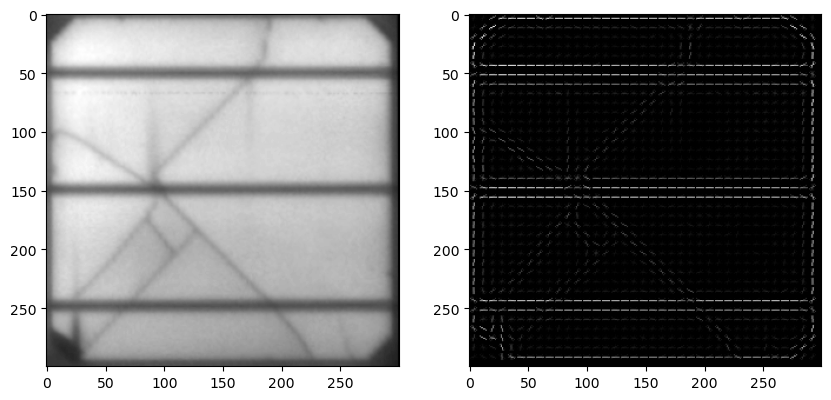

Class: 3, HOG shape: (46656,)


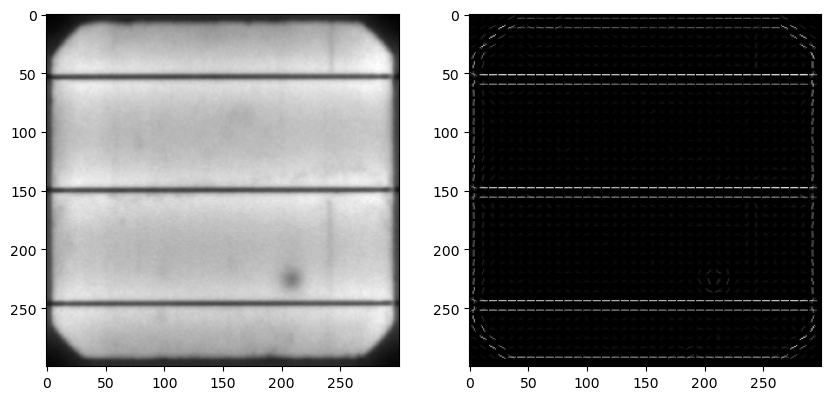

Class: 4, HOG shape: (46656,)


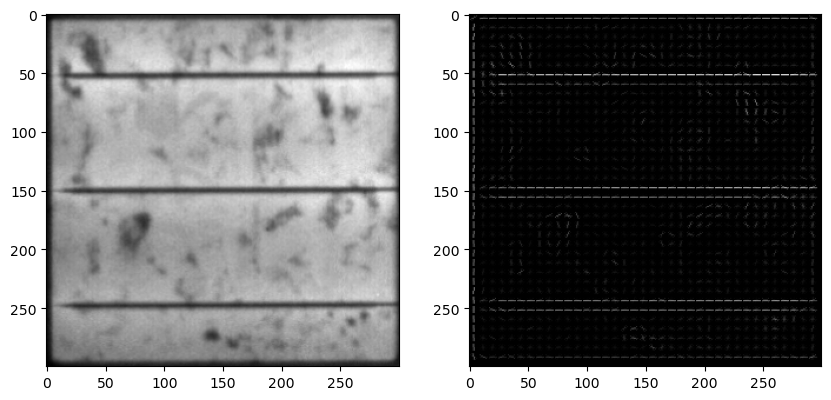

Class: 4, HOG shape: (46656,)


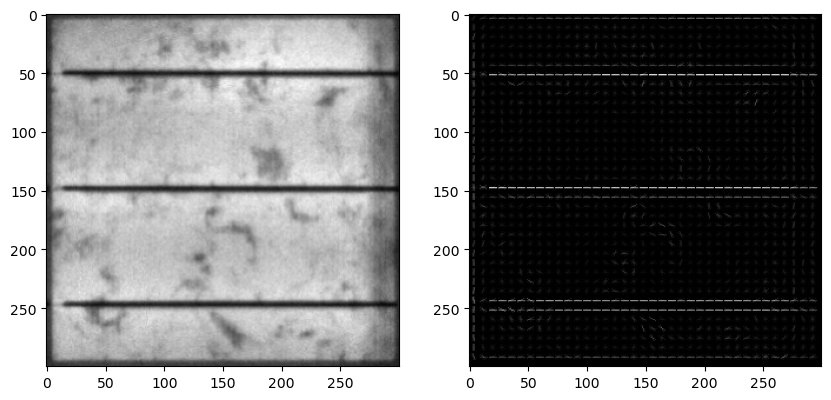

Class: 4, HOG shape: (46656,)


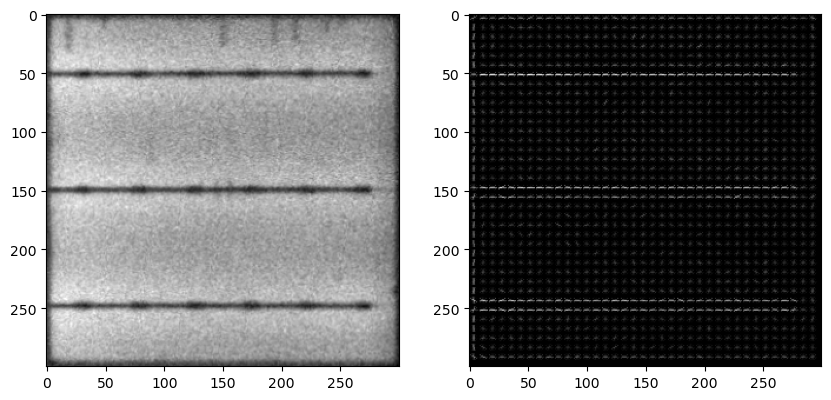

Class: 4, HOG shape: (46656,)


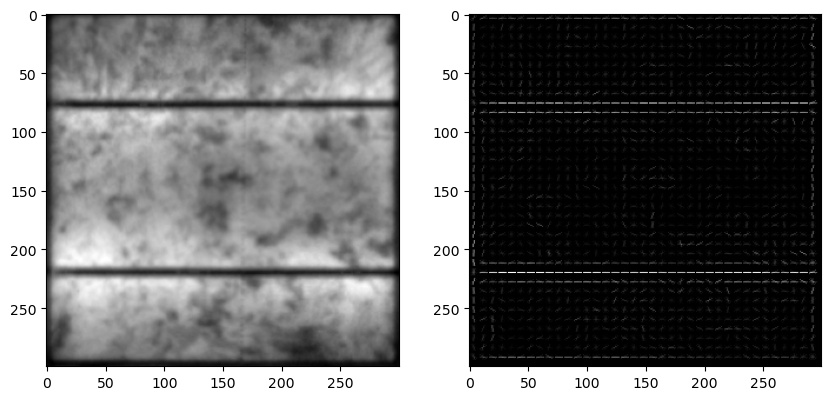

Class: 4, HOG shape: (46656,)


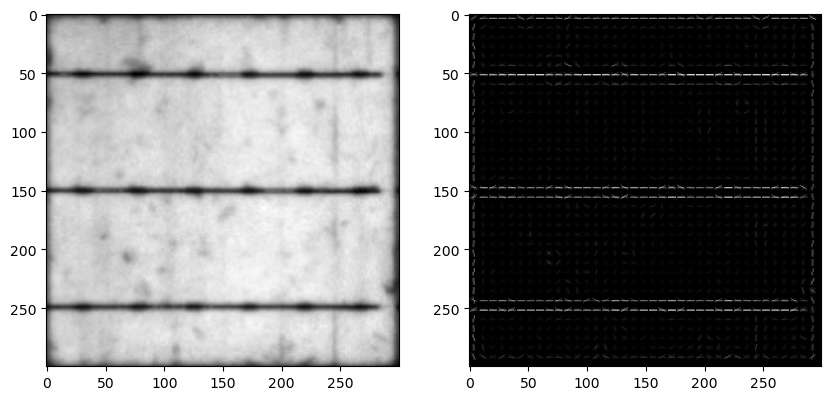

Class: 5, HOG shape: (46656,)


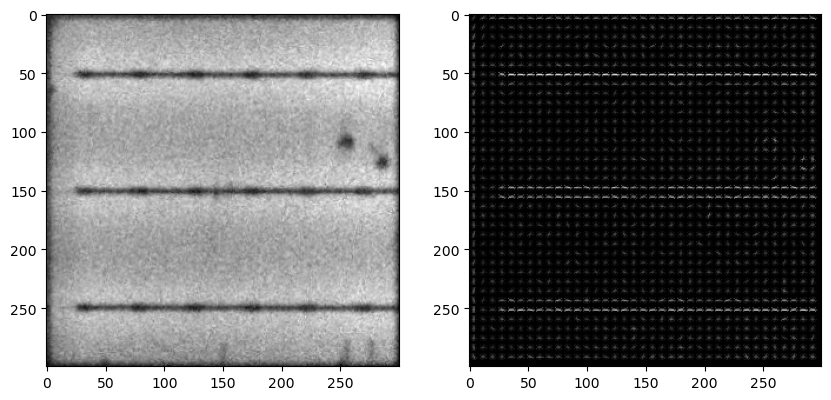

Class: 5, HOG shape: (46656,)


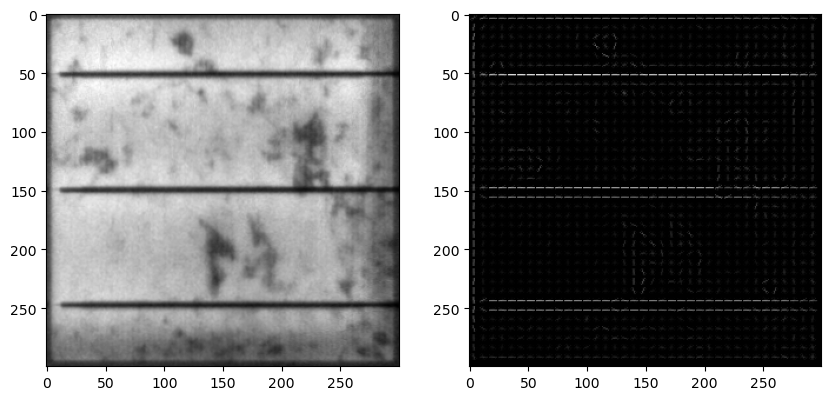

Class: 5, HOG shape: (46656,)


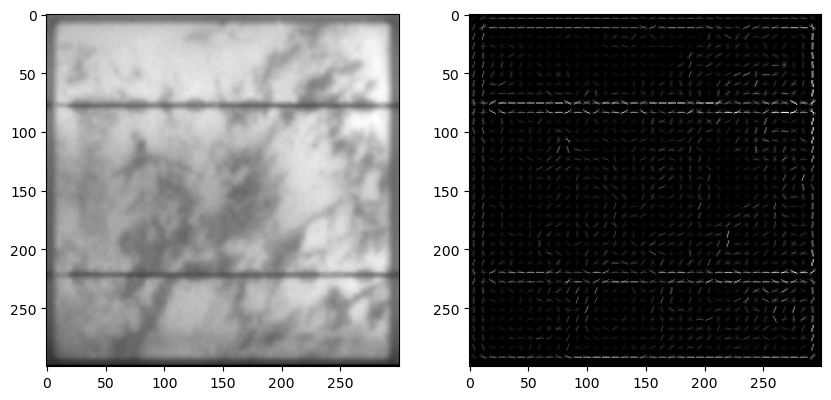

Class: 5, HOG shape: (46656,)


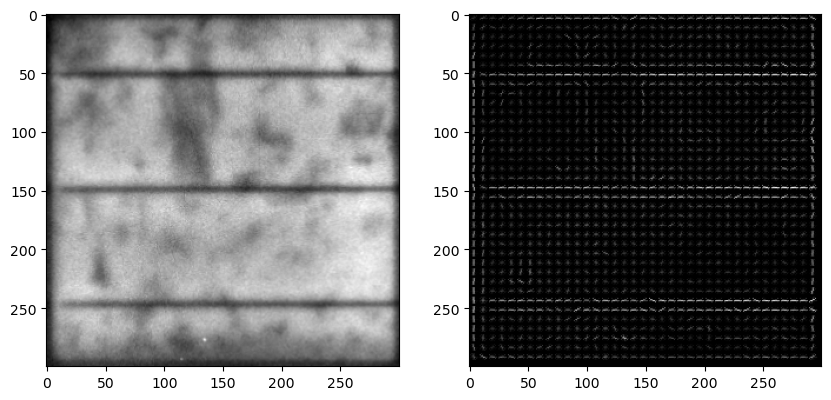

Class: 5, HOG shape: (46656,)


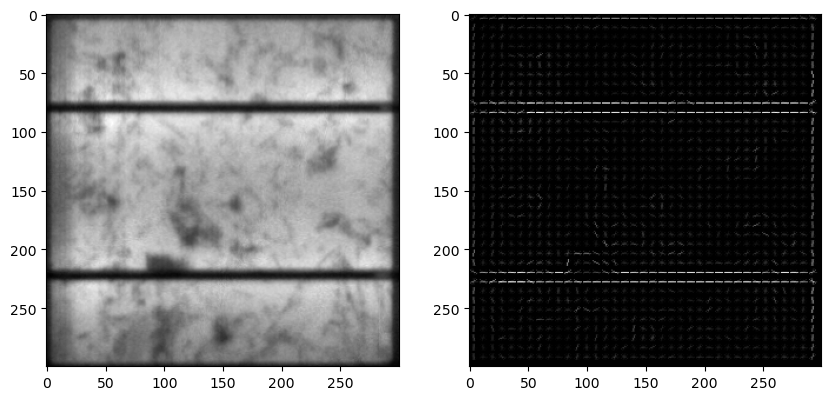

Class: 6, HOG shape: (46656,)


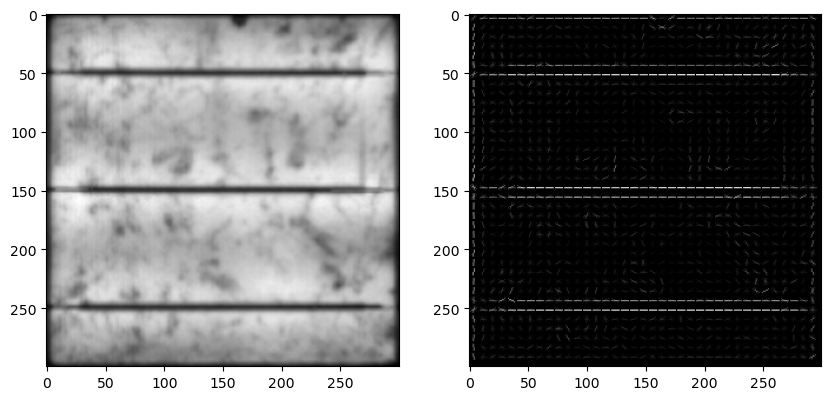

Class: 6, HOG shape: (46656,)


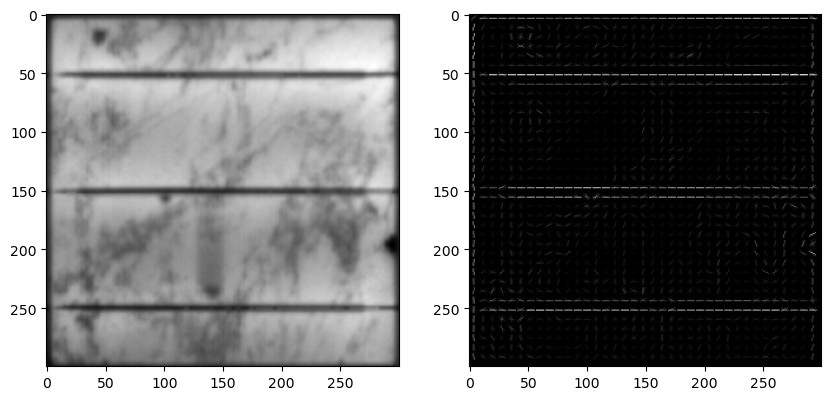

Class: 6, HOG shape: (46656,)


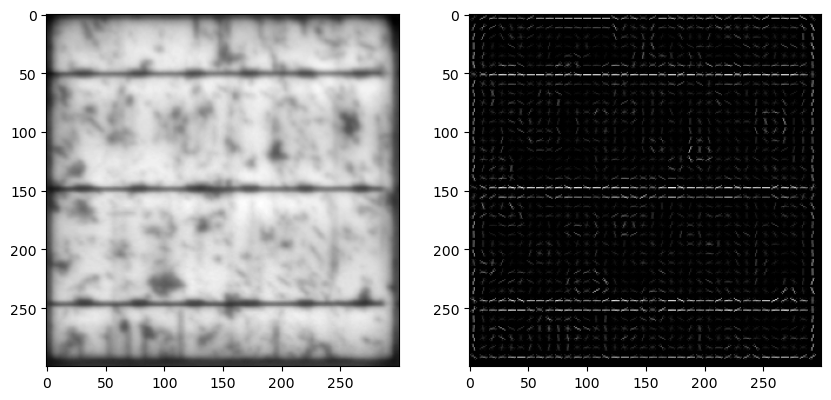

Class: 6, HOG shape: (46656,)


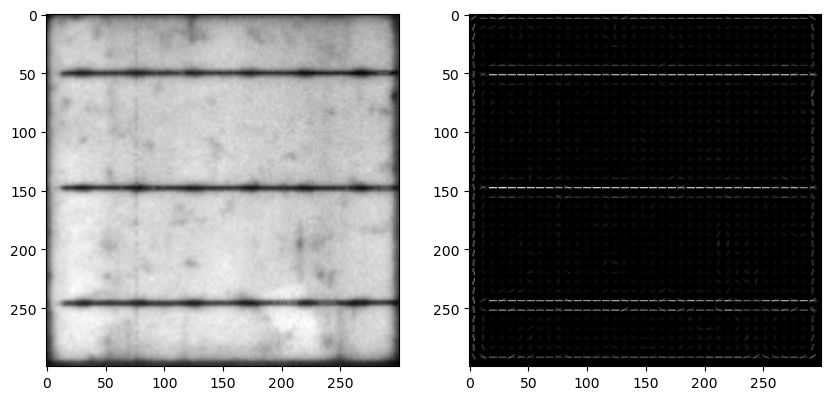

Class: 6, HOG shape: (46656,)


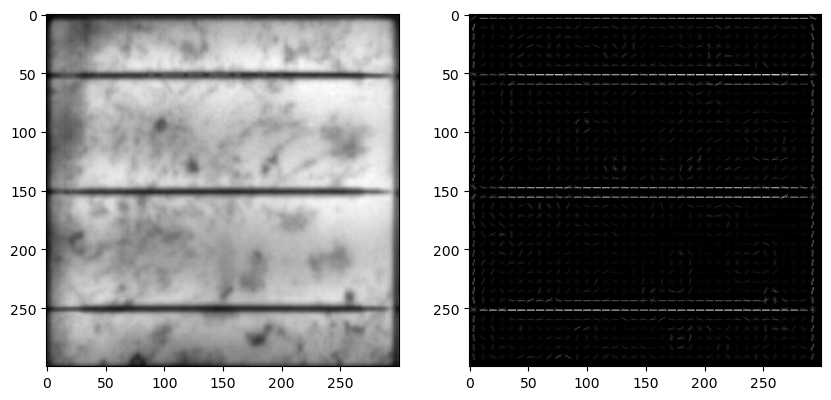

Class: 7, HOG shape: (46656,)


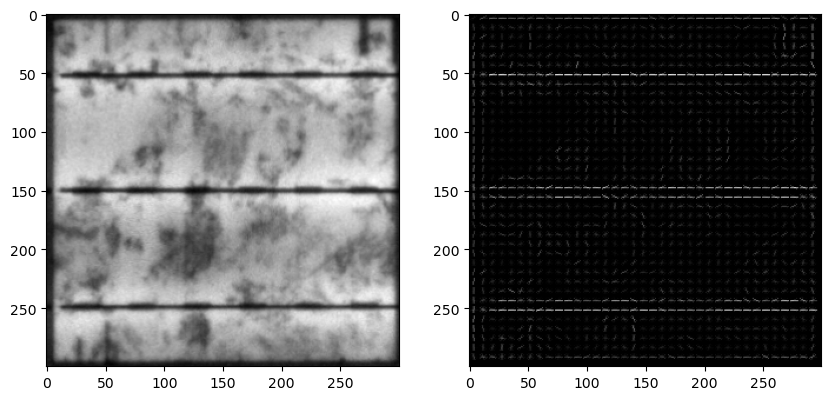

Class: 7, HOG shape: (46656,)


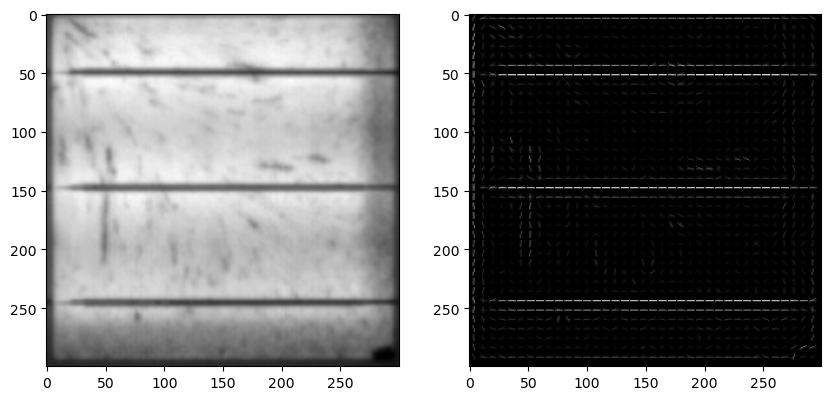

Class: 7, HOG shape: (46656,)


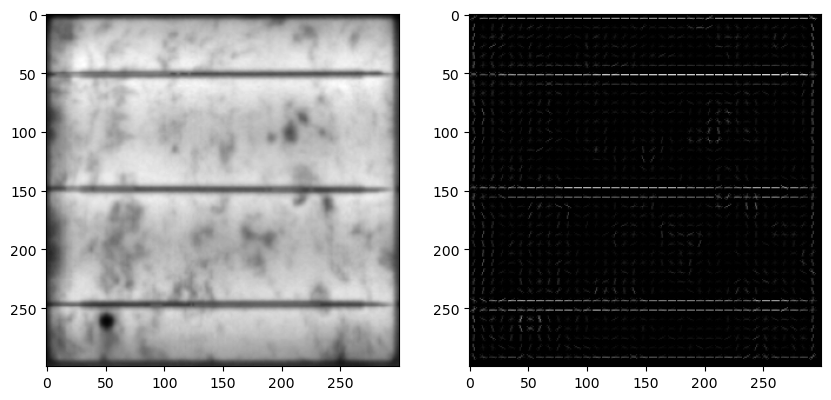

Class: 7, HOG shape: (46656,)


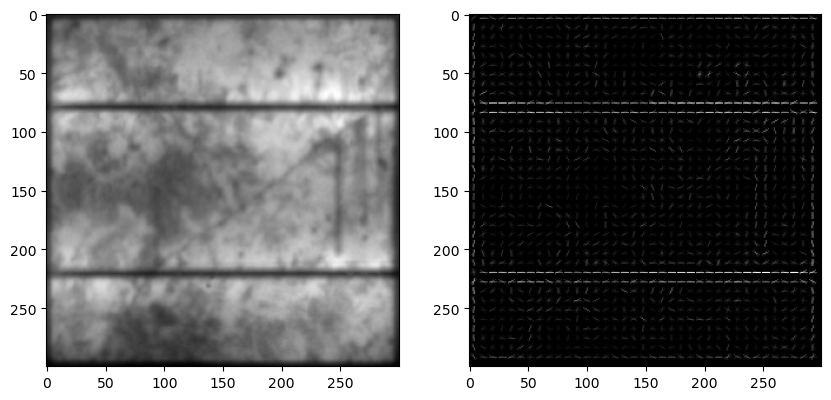

Class: 7, HOG shape: (46656,)


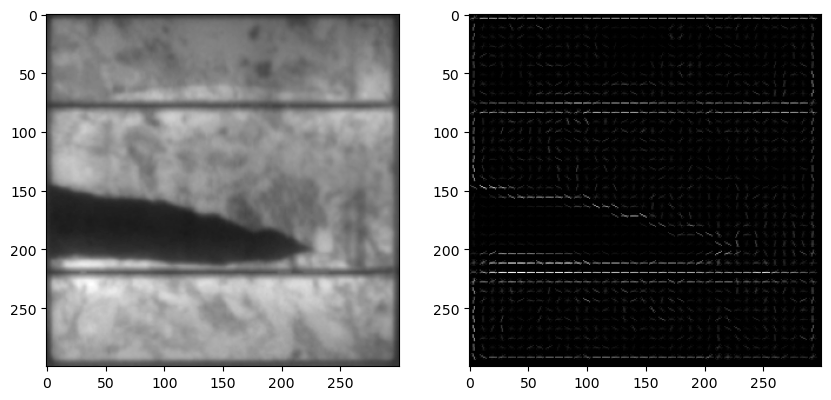

In [7]:
from skimage.feature import hog

for k, value in grouped_indices.items():
    for i in value:

        
        img = cv.imread(os.path.join(DATA_PATH, img_path[i]), 0)
        fd, hog_img = hog(img,
                          orientations = 9,
                          pixels_per_cell = (8,8),
                          cells_per_block=(2,2),
                          visualize=True,
                          feature_vector=True)
        
        fig, ax = plt.subplots(1, 2, figsize=(10,5))
        
        ax[0].imshow(img, cmap='gray')
        ax[1].imshow(hog_img, cmap='gray')

        print(f'Class: {labels[i]}, HOG shape: {fd.shape}')
        plt.show()
                


In [ ]:
grouped_indices

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv
import os

sift = cv.SIFT_create()
flag = True

for k, value in grouped_indices.items():
    for i in value:
        n = 6
        img = cv.imread(os.path.join(DATA_PATH, img_path[i]), 0)
        gaussian_out = cv.GaussianBlur(img, (0,0), 3)
        lap_out = cv.Laplacian(gaussian_out, -1, ksize=3)
        lap_out1 = cv.Laplacian(gaussian_out, -1, ksize=5)
        
        clach_out = clach_img(lap_out)
        clach_out1 = clach_img(lap_out1)

        fig, ax = plt.subplots(2, n, figsize=(5*n, 10), gridspec_kw={'height_ratios': [3, 1]})
        
        # Display images
        ax[0, 0].imshow(img, cmap='gray')
        ax[0, 0].set_title('Original')
        ax[0, 1].imshow(gaussian_out, cmap='gray')
        ax[0, 1].set_title('Gaussian')
        ax[0, 2].imshow(lap_out, cmap='gray')
        ax[0, 2].set_title('Laplacian')
        ax[0, 3].imshow(lap_out1, cmap='gray')
        ax[0, 3].set_title('Laplacian 5x5')
        ax[0, 4].imshow(clach_out, cmap='gray')
        ax[0, 4].set_title('CLAHE on Laplacian')
        ax[0, 5].imshow(clach_out1, cmap='gray')
        ax[0, 5].set_title('CLAHE on Laplacian 5x5')

        # Plot histograms
        for j, image in enumerate([img, gaussian_out, lap_out, lap_out1, clach_out, clach_out1]):
            hist = cv.calcHist([image], [0], None, [256], [0, 256])
            ax[1, j].plot(hist)
            ax[1, j].set_xlim([0, 256])
            ax[1, j].set_ylim([0, np.max(hist)])
            if j > 0:  # Clear y-axis labels for all but the first histogram for clarity
                ax[1, j].set_yticklabels([])

        # Turn off axis labels for the image plots
        for a in ax[0, :]:
            a.axis('off')

        if flag:
            print(lap_out.shape)
            print(lap_out[0])
            flag = False

        print(f'Class: {labels[i]}, {img_path[i]}, {prob[i]}, {types[i]}')
        plt.tight_layout()
        plt.show()


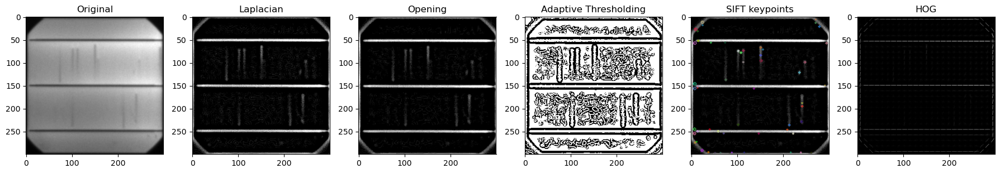

(300, 300)
Class: 0, images/cell1077.png, 0.0, mono
Hog size: (69696,)


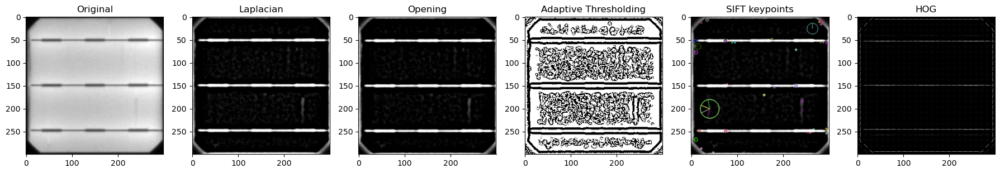

Class: 0, images/cell1176.png, 0.0, mono
Hog size: (69696,)


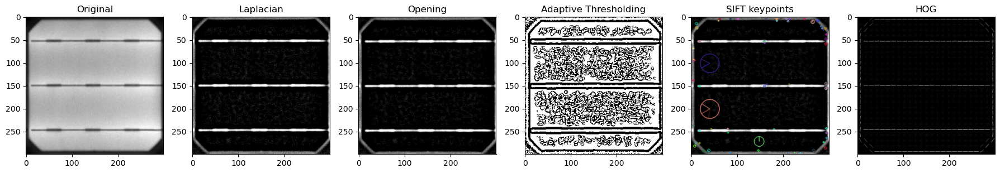

Class: 0, images/cell1569.png, 0.0, mono
Hog size: (69696,)


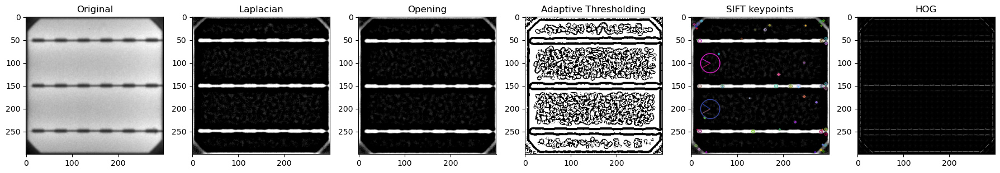

Class: 0, images/cell1131.png, 0.0, mono
Hog size: (69696,)


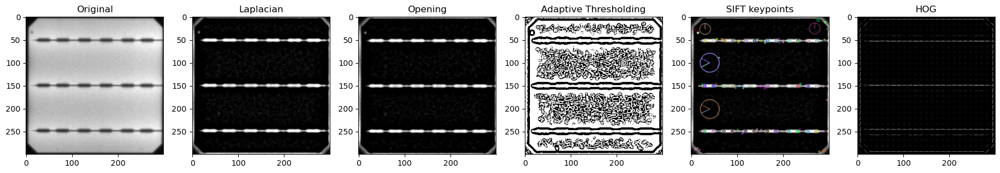

Class: 0, images/cell1289.png, 0.0, mono
Hog size: (69696,)


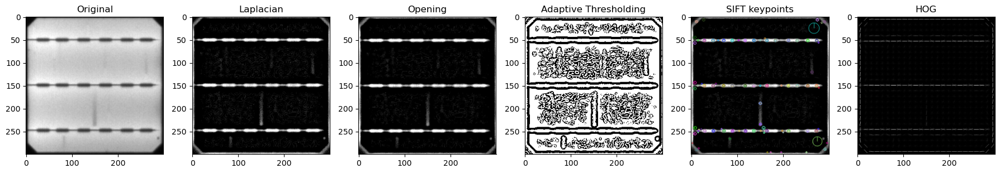

Class: 1, images/cell1301.png, 0.3333333333333333, mono
Hog size: (69696,)


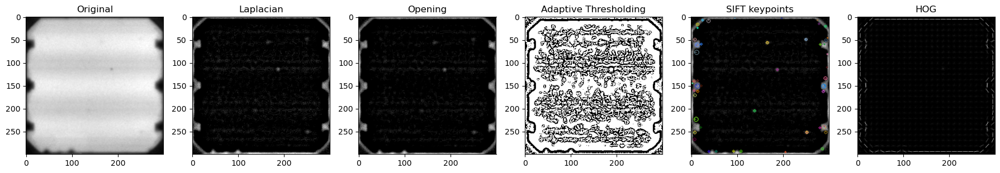

Class: 1, images/cell2212.png, 0.3333333333333333, mono
Hog size: (69696,)


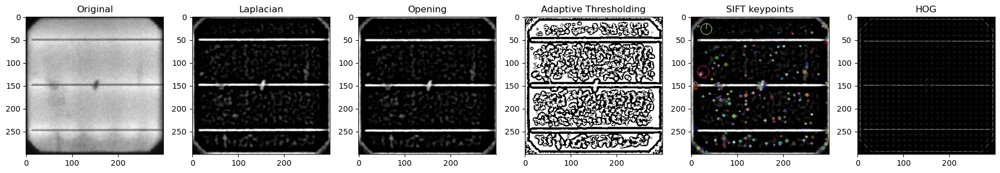

Class: 1, images/cell2400.png, 0.3333333333333333, mono
Hog size: (69696,)


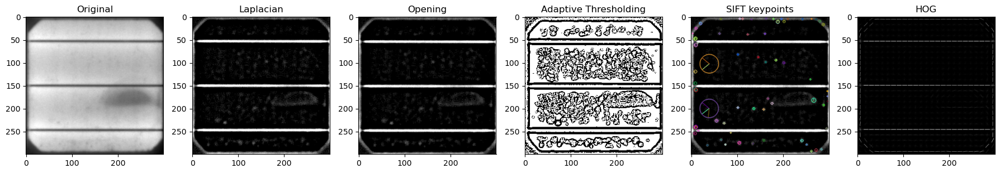

Class: 1, images/cell1476.png, 0.3333333333333333, mono
Hog size: (69696,)


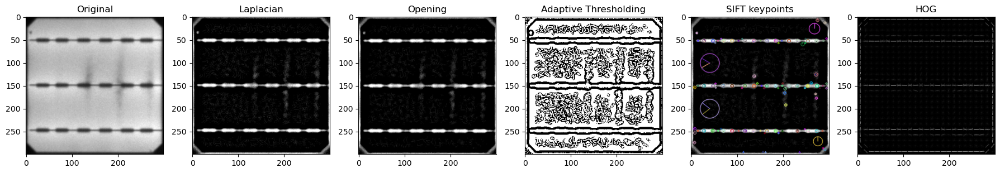

Class: 1, images/cell1325.png, 0.3333333333333333, mono
Hog size: (69696,)


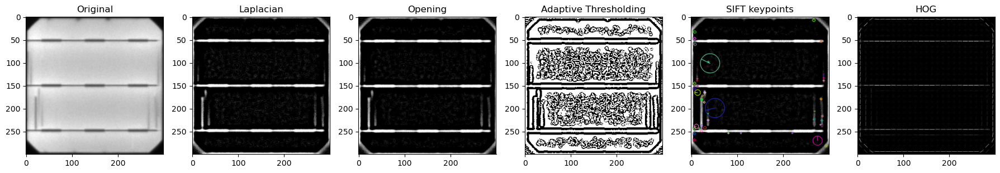

Class: 2, images/cell1187.png, 0.6666666666666666, mono
Hog size: (69696,)


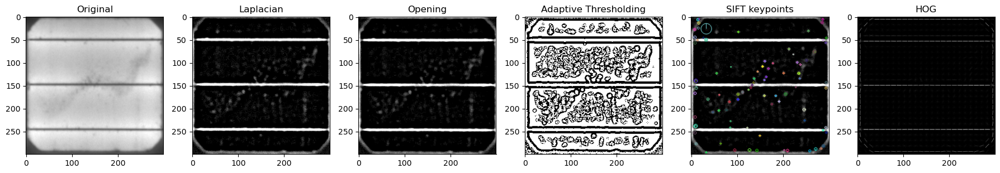

Class: 2, images/cell1382.png, 0.6666666666666666, mono
Hog size: (69696,)


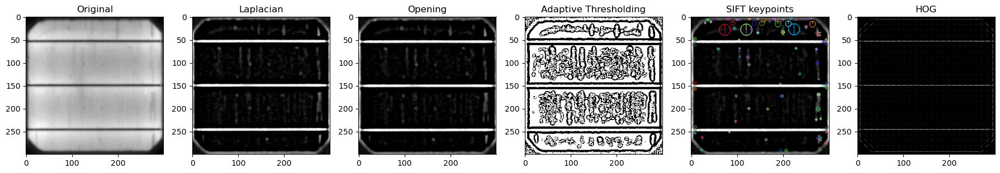

Class: 2, images/cell1393.png, 0.6666666666666666, mono
Hog size: (69696,)


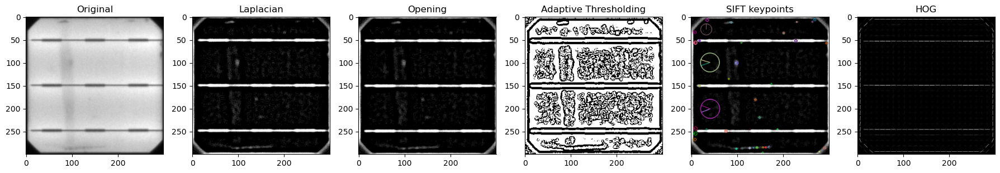

Class: 2, images/cell1177.png, 0.6666666666666666, mono
Hog size: (69696,)


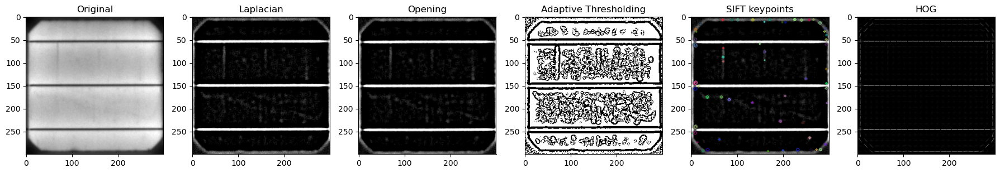

Class: 2, images/cell1457.png, 0.6666666666666666, mono
Hog size: (69696,)


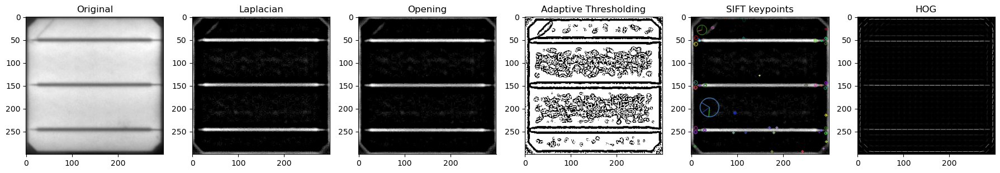

Class: 3, images/cell0482.png, 1.0, mono
Hog size: (69696,)


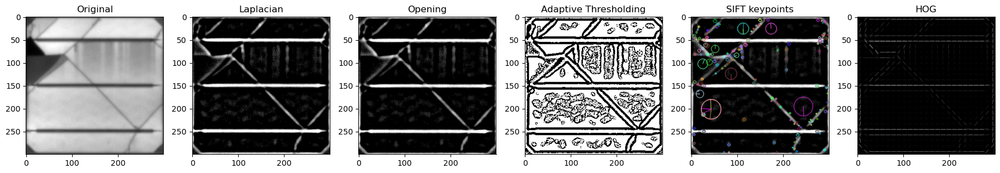

Class: 3, images/cell0406.png, 1.0, mono
Hog size: (69696,)


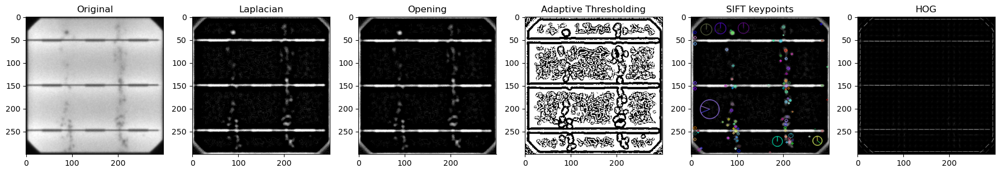

Class: 3, images/cell1221.png, 1.0, mono
Hog size: (69696,)


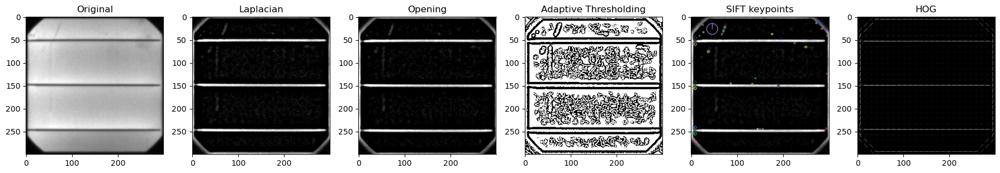

Class: 3, images/cell1044.png, 1.0, mono
Hog size: (69696,)


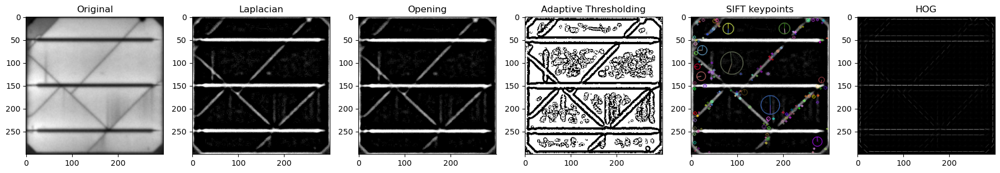

Class: 3, images/cell0388.png, 1.0, mono
Hog size: (69696,)


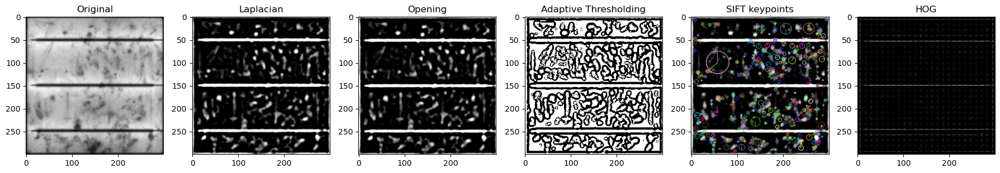

Class: 4, images/cell2353.png, 0.0, poly
Hog size: (69696,)


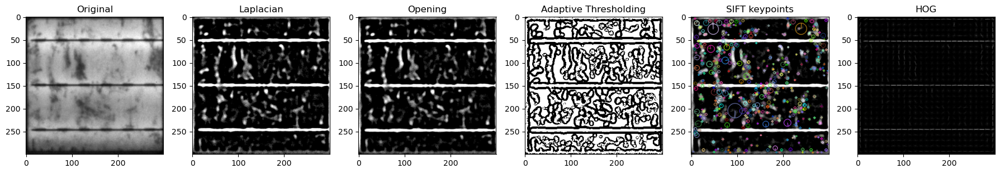

Class: 4, images/cell2056.png, 0.0, poly
Hog size: (69696,)


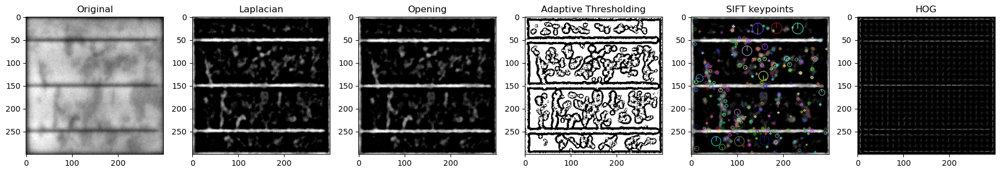

Class: 4, images/cell2284.png, 0.0, poly
Hog size: (69696,)


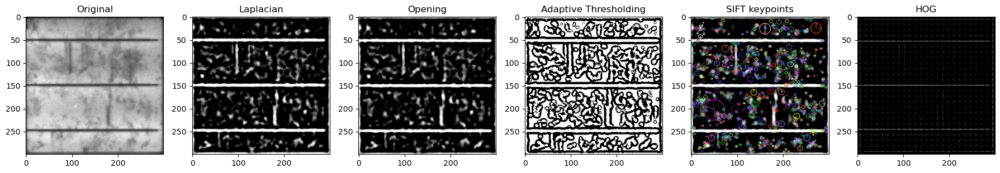

Class: 4, images/cell1846.png, 0.0, poly
Hog size: (69696,)


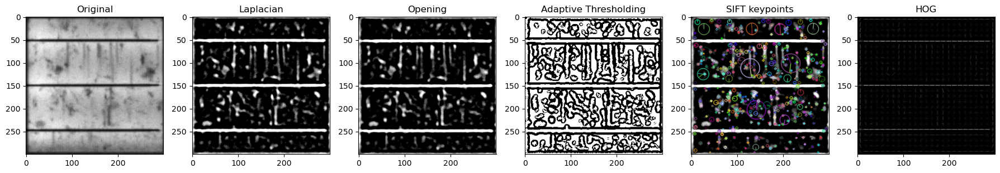

Class: 4, images/cell1874.png, 0.0, poly
Hog size: (69696,)


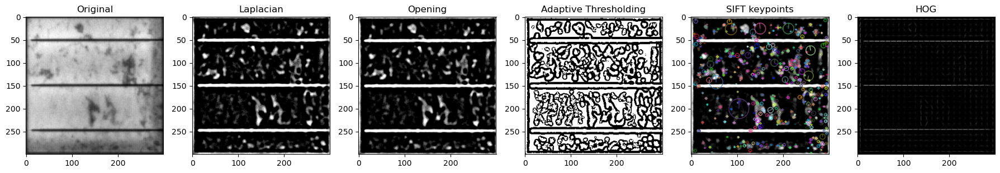

Class: 5, images/cell1823.png, 0.3333333333333333, poly
Hog size: (69696,)


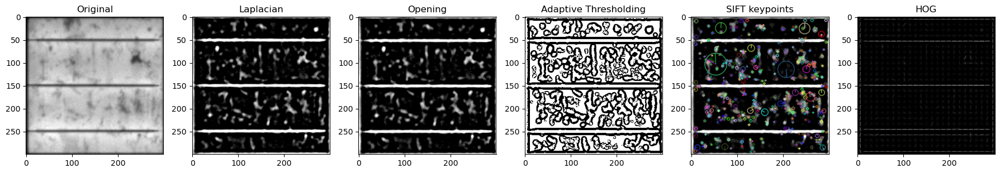

Class: 5, images/cell2565.png, 0.3333333333333333, poly
Hog size: (69696,)


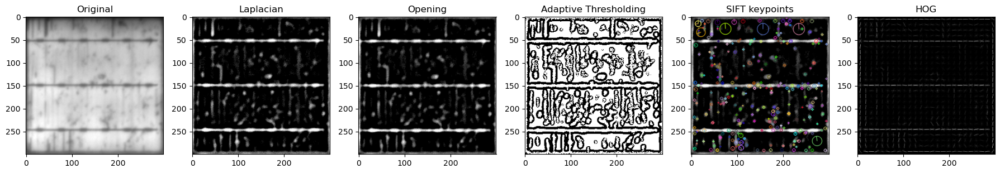

Class: 5, images/cell0669.png, 0.3333333333333333, poly
Hog size: (69696,)


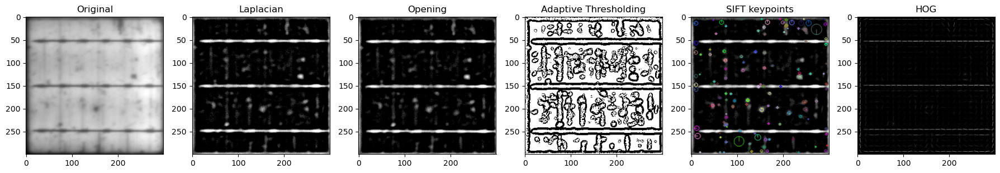

Class: 5, images/cell0711.png, 0.3333333333333333, poly
Hog size: (69696,)


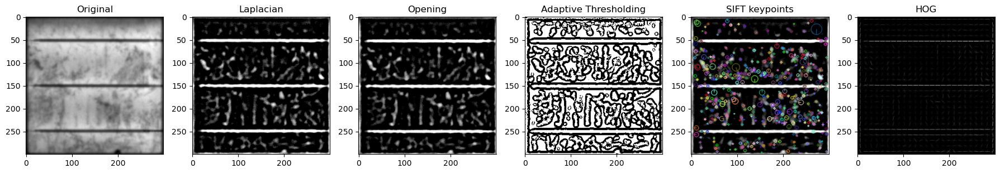

Class: 5, images/cell0818.png, 0.3333333333333333, poly
Hog size: (69696,)


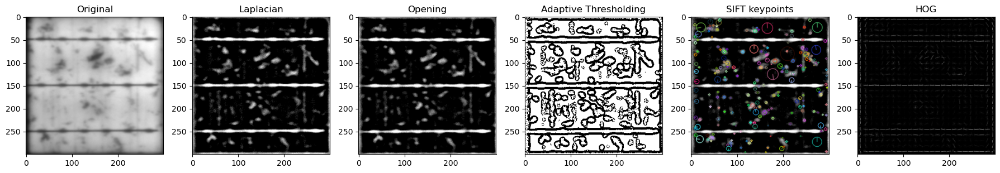

Class: 6, images/cell0701.png, 0.6666666666666666, poly
Hog size: (69696,)


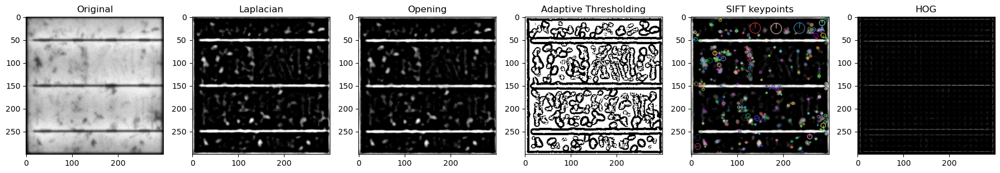

Class: 6, images/cell2555.png, 0.6666666666666666, poly
Hog size: (69696,)


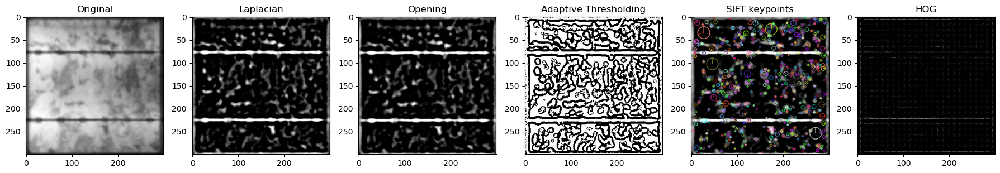

Class: 6, images/cell0866.png, 0.6666666666666666, poly
Hog size: (69696,)


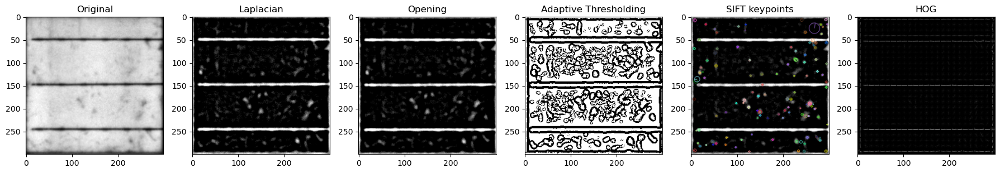

Class: 6, images/cell0758.png, 0.6666666666666666, poly
Hog size: (69696,)


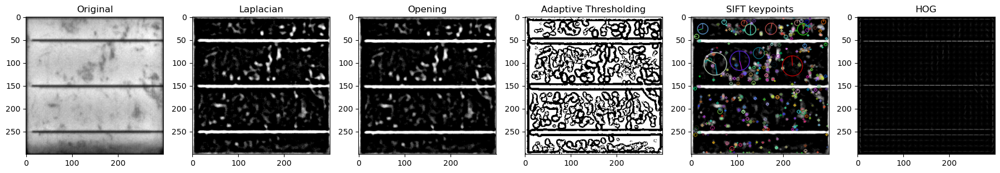

Class: 6, images/cell1839.png, 0.6666666666666666, poly
Hog size: (69696,)


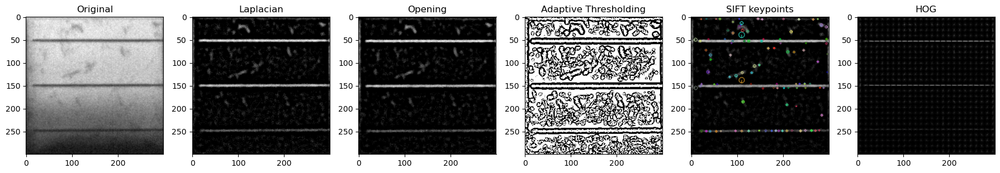

Class: 7, images/cell1843.png, 1.0, poly
Hog size: (69696,)


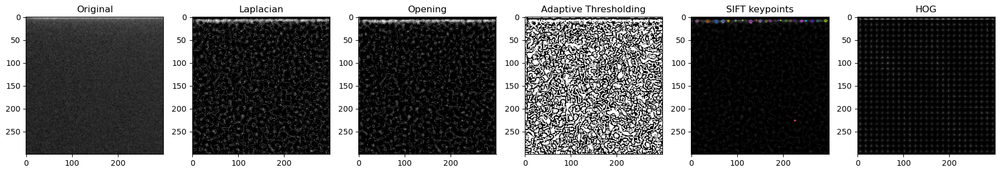

Class: 7, images/cell1895.png, 1.0, poly
Hog size: (69696,)


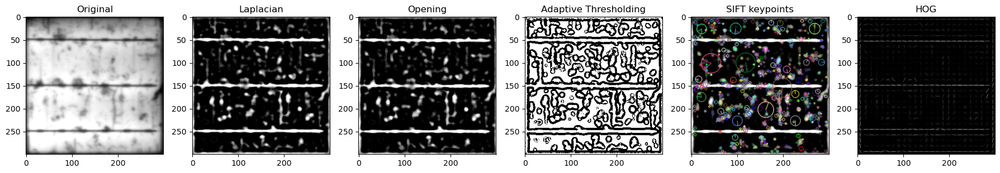

Class: 7, images/cell0645.png, 1.0, poly
Hog size: (69696,)


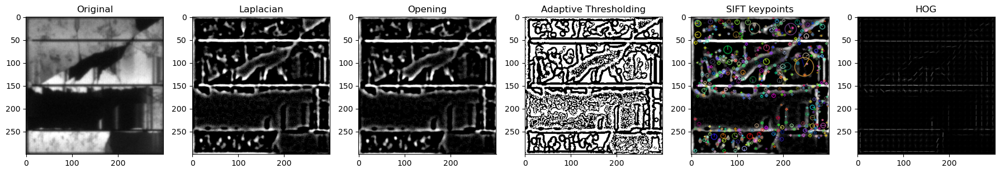

Class: 7, images/cell1627.png, 1.0, poly
Hog size: (69696,)


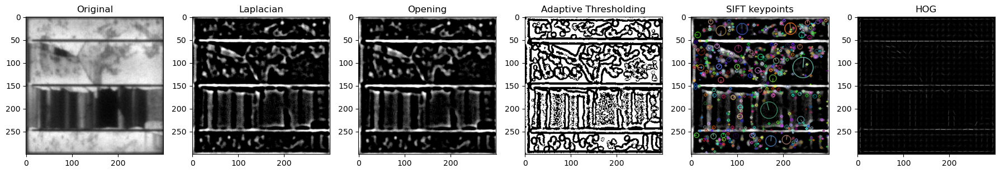

Class: 7, images/cell1646.png, 1.0, poly
Hog size: (69696,)


In [47]:
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv
import os
from skimage.feature import hog

n = 6
flag = True
sift = cv.SIFT_create(contrastThreshold = 0.06
                      )
# hog = cv.HOGDescriptor(_winSize = (300, 300),
#                         _blockSize = (50,50),
#                         _blockStride = (25,25),
#                         _cellSize = (25,25),
#                         _nbins = 9)
result = []
for k, value in grouped_indices.items():
    for i in value:
        img = cv.imread(os.path.join(DATA_PATH, img_path[i]), 0)
        clach_out = clach_img(img)
        gaussian_out = cv.GaussianBlur(clach_out, (0,0), 3)
        lap_out = cv.Laplacian(gaussian_out, -1, ksize=5)
        
        # Morphological opening on the Laplacian image
        kernel = np.ones((2,2), np.uint8)
        opening = cv.morphologyEx(lap_out, cv.MORPH_OPEN, kernel)
        # opening = cv.morphologyEx(opening, cv.MORPH_OPEN, kernel)
        # opening = cv.morphologyEx(opening, cv.MORPH_OPEN, kernel)
        # Adaptive thresholding on the Laplacian image
        adaptive_thresh = cv.adaptiveThreshold(opening.astype(np.uint8), 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                               cv.THRESH_BINARY, 11, 2)
        
        kp1, _ = sift.detectAndCompute(opening, None)
        opening_kp = cv.drawKeypoints(opening, kp1, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        fd, hog_out = hog(img, orientations=9, pixels_per_cell=(12,12),
                    cells_per_block=(4,4), visualize=True, block_norm='L2-Hys')
        
        # Append images for plotting
        result.append((img, lap_out, opening, adaptive_thresh, opening_kp, hog_out, i))

# Plotting
for img, lap_out, opening, adaptive_thresh,opening_kp, hog_out, i in result:
    fig, axes = plt.subplots(1,n, figsize=(3*n, 3))

    # Original image
    axes[0].imshow(img, cmap='gray')
    axes[0].set_title('Original')

    # Laplacian image
    axes[1].imshow(lap_out, cmap='gray')
    axes[1].set_title('Laplacian')

    # Opening image
    axes[2].imshow(opening, cmap='gray')
    axes[2].set_title('Opening')

    # Adaptive Thresholding image
    axes[3].imshow(adaptive_thresh, cmap='gray')
    axes[3].set_title('Adaptive Thresholding')
    
    axes[4].imshow(opening_kp, cmap='gray')
    axes[4].set_title('SIFT keypoints')
    
    axes[5].imshow(hog_out, cmap='gray')
    axes[5].set_title('HOG')

    # Canny Edge image

    # Adjust layout
    plt.tight_layout()
    plt.show()
    if flag:
        print(opening.shape)
        flag = False
    # Print image information
    print(f'Class: {labels[i]}, {img_path[i]}, {prob[i]}, {types[i]}')
    print(f'Hog size: {fd.shape}')
